<a href="https://colab.research.google.com/github/Purnata26/Machine-learning/blob/master/study1_collected_data_plots.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [ ]:
file_path = '/content/simulation.log'

# Read the file
with open(file_path, 'r') as file:
    log_data = file.readlines()

print(log_data)


['[INFO][2025.01.06 16:28:54:483]::Simulation Started\n', '[INFO][2025.01.06 16:28:54:504]::User name: Kael\n', '[INFO][2025.01.06 16:28:54:538]::headset not worn\n', '[INFO][2025.01.06 16:28:55:216]::headset not worn\n', '[INFO][2025.01.06 16:28:55:265]::headset not worn\n', '[INFO][2025.01.06 16:28:55:382]::headset not worn\n', '[INFO][2025.01.06 16:28:55:489]::headset not worn\n', '[INFO][2025.01.06 16:28:55:574]::headset not worn\n', '[INFO][2025.01.06 16:28:55:670]::headset not worn\n', '[INFO][2025.01.06 16:28:55:769]::headset not worn\n', '[INFO][2025.01.06 16:28:55:869]::headset not worn\n', '[INFO][2025.01.06 16:28:55:971]::headset not worn\n', '[INFO][2025.01.06 16:28:56:081]::headset not worn\n', '[INFO][2025.01.06 16:28:56:194]::headset not worn\n', '[INFO][2025.01.06 16:28:56:305]::headset not worn\n', '[INFO][2025.01.06 16:28:56:415]::headset not worn\n', '[INFO][2025.01.06 16:28:56:527]::headset not worn\n', '[INFO][2025.01.06 16:28:56:604]::headset not worn\n', '[INFO][

setu vai's data

In [ ]:
import csv
import re

file_path = '/content/simulation.log'
output_csv = '/content/sigmapercent_feedback.csv'

# Pattern to extract timestamp
time_pattern = r"\[INFO\]\[(\d{4}\.\d{2}\.\d{2} \d{2}:\d{2}:\d{2}:\d{3})\]"

# Initialize lists to store data
sigma_data = []
feedback_times = []

# Read the file line by line
with open(file_path, 'r') as file:
    for line in file:
        # Extract timestamp using the provided pattern
        timestamp_match = re.search(time_pattern, line)
        if timestamp_match:
            timestamp = timestamp_match.group(1)

            # Extract sigmaPercent values
            if 'Adjusted sigmaPercent' in line:
                matched_time = re.search(time_pattern, line).group(1)
                sigma_value = re.search(r'Adjusted sigmaPercent: ([0-9.]+)', line).group(1)
                sigma_data.append([matched_time, sigma_value])

            # Extract verbal feedback timestamps
            if 'Verbal feedback collected' in line:
                matched_time2 = re.search(time_pattern, line).group(1)
                feedback_times.append(matched_time2)




In [ ]:
feedback_times

['2025.01.06 16:28:57:845',
 '2025.01.06 16:28:57:935',
 '2025.01.06 16:28:57:980',
 '2025.01.06 16:28:58:025',
 '2025.01.06 16:28:58:114',
 '2025.01.06 16:28:58:156',
 '2025.01.06 16:28:58:240',
 '2025.01.06 16:28:58:282',
 '2025.01.06 16:28:58:324',
 '2025.01.06 16:28:58:402',
 '2025.01.06 16:28:58:443',
 '2025.01.06 16:28:58:523',
 '2025.01.06 16:28:58:561',
 '2025.01.06 16:28:58:602',
 '2025.01.06 16:28:58:680',
 '2025.01.06 16:28:58:720',
 '2025.01.06 16:28:58:798',
 '2025.01.06 16:28:58:836',
 '2025.01.06 16:28:58:913',
 '2025.01.06 16:28:58:949',
 '2025.01.06 16:28:58:988',
 '2025.01.06 16:28:59:065',
 '2025.01.06 16:28:59:104',
 '2025.01.06 16:28:59:178',
 '2025.01.06 16:28:59:215',
 '2025.01.06 16:28:59:251',
 '2025.01.06 16:28:59:316',
 '2025.01.06 16:28:59:346',
 '2025.01.06 16:28:59:415',
 '2025.01.06 16:28:59:447',
 '2025.01.06 16:28:59:479',
 '2025.01.06 16:28:59:547',
 '2025.01.06 16:28:59:579',
 '2025.01.06 16:28:59:644',
 '2025.01.06 16:28:59:675',
 '2025.01.06 16:28:5

In [ ]:
with open(output_csv, 'w', newline='') as csvfile:
    csv_writer = csv.writer(csvfile)
    csv_writer.writerow(['Timestamp', 'SigmaPercent'])

    # Merge sigma data and feedback times
    for sigma in sigma_data:
        timestamp, value = sigma
        # Write the row
        csv_writer.writerow([timestamp, value])

print(f"Data has been saved to {output_csv}")

Data has been saved to /content/sigmapercent_feedback.csv


In [ ]:
import csv
import re

file_path = '/content/simulation.log'
output_csv = '/content/sigmapercent_feedback.csv'


time_pattern = r"\[INFO\]\[(\d{4}\.\d{2}\.\d{2} \d{2}:\d{2}:\d{2}:\d{3})\]"

# Initialize lists to store data
sigma_data = []
feedback_times = []

# Flag to start collecting data
collect_data = False

# Read the file line by line
with open(file_path, 'r') as file:
    for line in file:
        # Check if we should start collecting data
        if 'User name: Guohao' in line:
            collect_data = True

        # Continue only if the flag is set
        if collect_data:
            # Extract timestamp using the provided pattern
            timestamp_match = re.search(time_pattern, line)
            if timestamp_match:
                timestamp = timestamp_match.group(1)

                # Extract sigmaPercent values
                if 'Adjusted sigmaPercent' in line:
                    sigma_value = re.search(r'Adjusted sigmaPercent: ([0-9.]+)', line).group(1)
                    sigma_data.append([timestamp, sigma_value])

                # Extract verbal feedback timestamps
                if 'EyeTracking data received and stored.' in line:
                    feedback_times.append(timestamp)




In [ ]:
with open(output_csv, 'w', newline='') as csvfile:
    csv_writer = csv.writer(csvfile)
    csv_writer.writerow(['Timestamp', 'SigmaPercent'])


    for sigma in sigma_data:
        timestamp, value = sigma

        csv_writer.writerow([timestamp, value])

print(f"Data has been saved to {output_csv}")

Data has been saved to /content/sigmapercent_feedback.csv


In [ ]:
df=pd.read_csv('/content/sigmapercent_feedback.csv')
df['Timestamp'] = pd.to_datetime(df['Timestamp'], format='%Y.%m.%d %H:%M:%S:%f')


In [ ]:
verbal_feedback=pd.DataFrame(feedback_times,columns=['Timestamp'])
verbal_feedback['Timestamp']=pd.to_datetime(verbal_feedback['Timestamp'],format='%Y.%m.%d %H:%M:%S:%f')
verbal_feedback

,Timestamp
0,2025-04-17 15:30:45.328
1,2025-04-17 15:31:15.324
2,2025-04-17 15:31:45.334
3,2025-04-17 15:32:15.337
4,2025-04-17 15:32:45.341
5,2025-04-17 15:33:15.350
6,2025-04-17 15:42:47.708
7,2025-04-17 15:43:17.715
8,2025-04-17 15:43:47.708
9,2025-04-17 15:44:17.714


In [ ]:
nearest_sigma = []
for feedback_time in feedback_times:

    feedback_time = pd.to_datetime(feedback_time, format='%Y.%m.%d %H:%M:%S:%f')
    time_diff = abs(df['Timestamp'] - feedback_time)
    nearest_index = time_diff.idxmin()
    nearest_sigma.append((feedback_time, df.loc[nearest_index, 'Timestamp'], df.loc[nearest_index, 'SigmaPercent']))

nearest_sigma_df = pd.DataFrame(nearest_sigma, columns=['Feedback Time', 'Nearest Sigma Timestamp', 'SigmaPercent'])
nearest_sigma_df=nearest_sigma_df.iloc[1:,:]
nearest_sigma_df.reset_index(drop=True,inplace=True)
nearest_sigma_df

ValueError: attempt to get argmin of an empty sequence

In [ ]:
fms=pd.read_csv('/content/fmsq_data.csv')
fms

,Order,FMSQ,Comment by participant
0,1,1,NaN
1,2,1,NaN
2,3,2,NaN
3,4,2,NaN
4,5,3,NaN
5,6,4,NaN
6,7,4,NaN
7,8,4,NaN
8,9,3,NaN
9,10,3,NaN


In [ ]:
nearest_sigma_df['reported_fms']=fms.FMSQ

nearest_sigma_df.dropna(inplace=True)
nearest_sigma_df

,Feedback Time,Nearest Sigma Timestamp,SigmaPercent,reported_fms
0,2025-02-12 14:42:24.323,2025-02-12 14:42:24.324,0.053455,1
1,2025-02-12 14:42:54.321,2025-02-12 14:42:54.323,0.676690,1
2,2025-02-12 14:43:24.334,2025-02-12 14:43:12.118,0.000000,2
3,2025-02-12 14:43:54.331,2025-02-12 14:43:54.332,0.942232,2
4,2025-02-12 14:44:24.325,2025-02-12 14:44:15.932,0.998969,3
5,2025-02-12 14:44:54.347,2025-02-12 14:45:07.584,1.000000,4
6,2025-02-12 14:45:24.355,2025-02-12 14:45:14.078,1.000000,4
7,2025-02-12 14:45:54.340,2025-02-12 14:46:21.390,0.998921,4
8,2025-02-12 14:46:24.349,2025-02-12 14:46:24.351,0.883404,3
9,2025-02-12 14:46:54.364,2025-02-12 14:47:01.485,0.693861,3


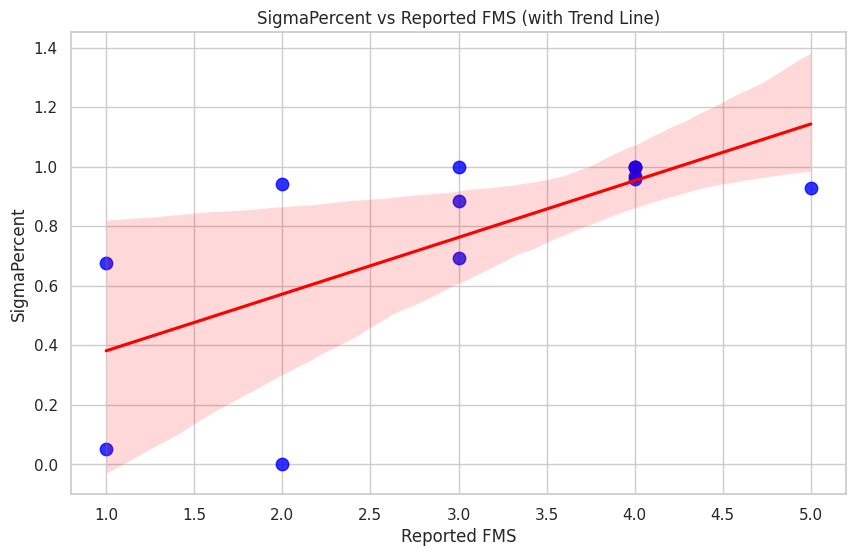

In [ ]:

nearest_sigma_df['reported_fms'] = pd.to_numeric(nearest_sigma_df['reported_fms'], errors='coerce')
filtered_df = nearest_sigma_df.dropna(subset=['reported_fms', 'SigmaPercent'])


sns.set(style="whitegrid")
plt.figure(figsize=(10, 6))
sns.regplot(x='reported_fms', y='SigmaPercent', data=filtered_df, marker='o', color='blue',
            scatter_kws={'s': 80}, line_kws={'color': 'red'})
plt.xlabel('Reported FMS')
plt.ylabel('SigmaPercent')
plt.title('SigmaPercent vs Reported FMS (with Trend Line)')
plt.grid(True)
plt.show()


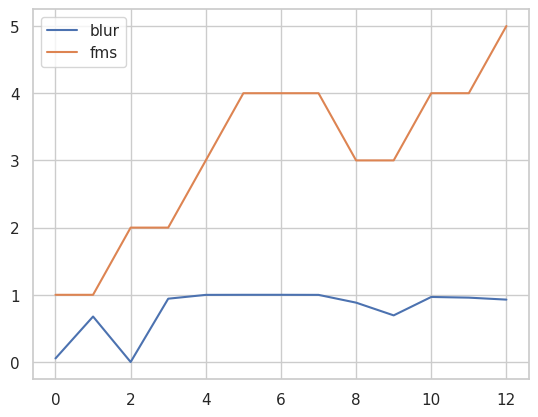

In [ ]:
plt.plot(filtered_df.SigmaPercent,label='blur')
plt.plot(filtered_df.reported_fms,label='fms')
plt.legend()
plt.show()

part- Michelle

In [ ]:
import csv
import re

file_path = '/content/simulation.log'
output_csv = '/content/sigmapercent_feedback.csv'

# Pattern to extract timestamp
time_pattern = r"\[INFO\]\[(\d{4}\.\d{2}\.\d{2} \d{2}:\d{2}:\d{2}:\d{3})\]"

# Initialize lists to store data
sigma_data = []
feedback_times = []

# Flag to start collecting data
collect_data = False

# Read the file line by line
with open(file_path, 'r') as file:
    for line in file:
        # Check if we should start collecting data
        if 'User name: Michelle' in line:
            collect_data = True

        # Continue only if the flag is set
        if collect_data:
            # Extract timestamp using the provided pattern
            timestamp_match = re.search(time_pattern, line)
            if timestamp_match:
                timestamp = timestamp_match.group(1)

                # Extract sigmaPercent values
                if 'Adjusted sigmaPercent' in line:
                    sigma_value = re.search(r'Adjusted sigmaPercent: ([0-9.]+)', line).group(1)
                    sigma_data.append([timestamp, sigma_value])

                # Extract verbal feedback timestamps
                if 'Verbal feedback collected' in line:
                    feedback_times.append(timestamp)




In [ ]:
with open(output_csv, 'w', newline='') as csvfile:
    csv_writer = csv.writer(csvfile)
    csv_writer.writerow(['Timestamp', 'SigmaPercent'])


    for sigma in sigma_data:
        timestamp, value = sigma

        csv_writer.writerow([timestamp, value])

print(f"Data has been saved to {output_csv}")

Data has been saved to /content/sigmapercent_feedback.csv


In [ ]:
df=pd.read_csv('/content/sigmapercent_feedback.csv')
df['Timestamp'] = pd.to_datetime(df['Timestamp'], format='%Y.%m.%d %H:%M:%S:%f')
df

,Timestamp,SigmaPercent
0,2025-03-10 13:17:15.184,0.001431
1,2025-03-10 13:17:15.199,0.005031
2,2025-03-10 13:17:15.215,0.012205
3,2025-03-10 13:17:15.236,0.030652
4,2025-03-10 13:17:15.252,0.049509
5,2025-03-10 13:17:15.267,0.068327
6,2025-03-10 13:17:15.291,0.087126
7,2025-03-10 13:17:15.312,0.105895
8,2025-03-10 13:17:15.327,0.124664
9,2025-03-10 13:17:15.341,0.143433


In [ ]:
verbal_feedback=pd.DataFrame(feedback_times,columns=['Timestamp'])
verbal_feedback['Timestamp']=pd.to_datetime(verbal_feedback['Timestamp'],format='%Y.%m.%d %H:%M:%S:%f')
verbal_feedback

,Timestamp
0,2025-03-10 13:17:38.366
1,2025-03-10 13:18:08.368
2,2025-03-10 13:18:38.372
3,2025-03-10 13:19:08.374
4,2025-03-10 13:19:38.381
5,2025-03-10 13:20:08.378


In [ ]:
nearest_sigma = []
for feedback_time in feedback_times:

    feedback_time = pd.to_datetime(feedback_time, format='%Y.%m.%d %H:%M:%S:%f')
    time_diff = abs(df['Timestamp'] - feedback_time)
    nearest_index = time_diff.idxmin()
    nearest_sigma.append((feedback_time, df.loc[nearest_index, 'Timestamp'], df.loc[nearest_index, 'SigmaPercent']))

nearest_sigma_df = pd.DataFrame(nearest_sigma, columns=['Feedback Time', 'Nearest Sigma Timestamp', 'SigmaPercent'])
nearest_sigma_df=nearest_sigma_df.iloc[1:,:]
nearest_sigma_df.reset_index(drop=True,inplace=True)
nearest_sigma_df

,Feedback Time,Nearest Sigma Timestamp,SigmaPercent
0,2025-03-10 13:18:08.368,2025-03-10 13:17:23.358,1.0
1,2025-03-10 13:18:38.372,2025-03-10 13:17:23.358,1.0
2,2025-03-10 13:19:08.374,2025-03-10 13:17:23.358,1.0
3,2025-03-10 13:19:38.381,2025-03-10 13:17:23.358,1.0
4,2025-03-10 13:20:08.378,2025-03-10 13:17:23.358,1.0


In [ ]:
fms=pd.read_csv('/content/michelle_study_log.csv')
nearest_sigma_df['reported_fms']=fms.FMSQ

nearest_sigma_df.dropna(inplace=True)
nearest_sigma_df

,Feedback Time,Nearest Sigma Timestamp,SigmaPercent,reported_fms
0,2025-03-10 13:18:08.368,2025-03-10 13:17:23.358,1.0,3
1,2025-03-10 13:18:38.372,2025-03-10 13:17:23.358,1.0,3
2,2025-03-10 13:19:08.374,2025-03-10 13:17:23.358,1.0,3
3,2025-03-10 13:19:38.381,2025-03-10 13:17:23.358,1.0,4
4,2025-03-10 13:20:08.378,2025-03-10 13:17:23.358,1.0,4


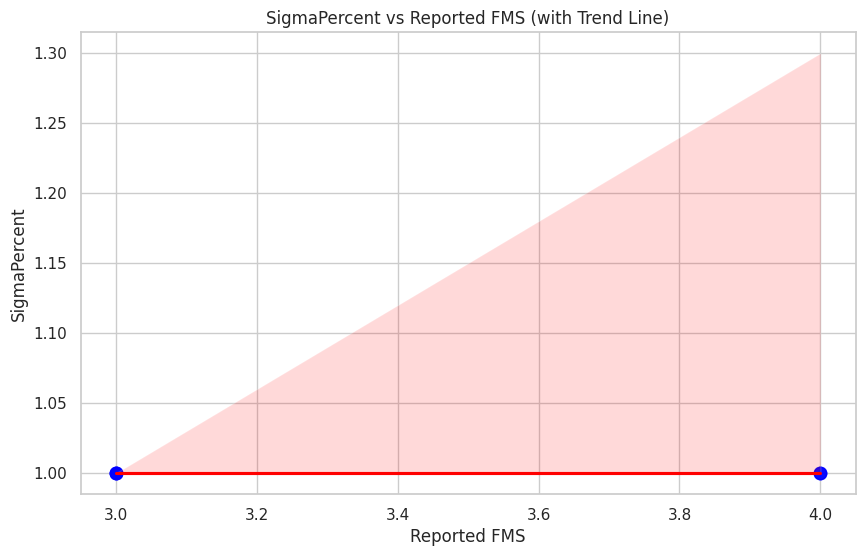

In [ ]:

nearest_sigma_df['reported_fms'] = pd.to_numeric(nearest_sigma_df['reported_fms'], errors='coerce')
filtered_df = nearest_sigma_df


sns.set(style="whitegrid")


plt.figure(figsize=(10, 6))
sns.regplot(x='reported_fms', y='SigmaPercent', data=filtered_df, marker='o', color='blue',
            scatter_kws={'s': 80}, line_kws={'color': 'red'})
plt.xlabel('Reported FMS')
plt.ylabel('SigmaPercent')
plt.title('SigmaPercent vs Reported FMS (with Trend Line)')
plt.grid(True)
plt.show()


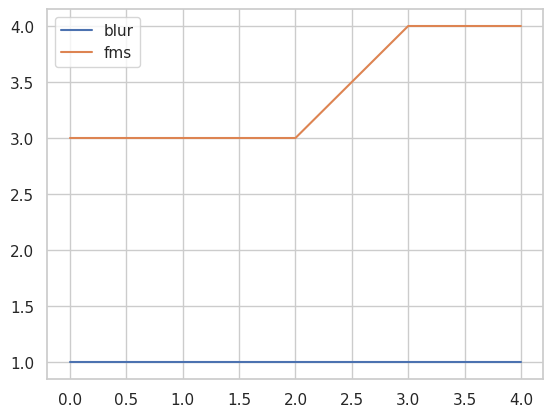

In [ ]:
plt.plot(filtered_df.SigmaPercent,label='blur')
plt.plot(filtered_df.reported_fms,label='fms')
plt.legend()
plt.show()

New study

Participant
Order
1
NB → DB → MB
2
NB → MB → DB
3
DB → NB → MB
4
DB → MB → NB
5
MB → NB → DB
6
MB → DB → NB




7
NB → DB → MB
8
NB → MB → DB
9
DB → NB → MB
10
DB → MB → NB
11
MB → NB → DB
12
MB → DB → NB










13
NB → DB → MB
14
NB → MB → DB
15
DB → NB → MB


For next 3 participants, the first 3 permutations will be done by Purnata and the next 3 will be done by Ridwan.


NB

In [ ]:
import pandas as pd


condition_1 = {
    "Condition": "NB",
    "FMSQ Scores": [0,0,0,0,0,0]
}


condition_2 = {
    "Condition": "DB",
    "FMSQ Scores": [0,0,0,0,0,0]
}


condition_3 = {
    "Condition": "Max Blur",
    "FMSQ Scores": [0,0,0,0,0,0]
}


data = {
    "NB": condition_1["FMSQ Scores"],
    "DB": condition_2["FMSQ Scores"],
    "MB": condition_3["FMSQ Scores"]
}

df = pd.DataFrame(data)

excel_path = "User10_FMS_Data.csv"
df.to_csv(excel_path, index=False)
df

,NB,DB,MB
0,0,0,0
1,0,0,0
2,0,0,0
3,0,0,0
4,0,0,0
5,0,0,0


In [ ]:
import pandas as pd

condition_nb = {
    "Condition": "NB",
    "FMSQ Scores": [4,4,4,4,4,4]
}

condition_mb = {
    "Condition": "MB",
    "FMSQ Scores": [3,3,3,4,3,5]
}

condition_db = {
    "Condition": "DB",
    "FMSQ Scores": [8,6,5,5,5,5]
}

# Create a dictionary with max length for each list
max_len = max(len(condition_nb["FMSQ Scores"]),
              len(condition_mb["FMSQ Scores"]),
              len(condition_db["FMSQ Scores"]))

data = {
    "NB": condition_nb["FMSQ Scores"] + [None] * (max_len - len(condition_nb["FMSQ Scores"])),
    "MB": condition_mb["FMSQ Scores"] + [None] * (max_len - len(condition_mb["FMSQ Scores"])),
    "DB": condition_db["FMSQ Scores"] + [None] * (max_len - len(condition_db["FMSQ Scores"]))
}

df = pd.DataFrame(data)

excel_path = "User15_FMS_Data.csv"
df.to_csv(excel_path, index=False)
df


,NB,MB,DB
0,4,3,8
1,4,3,6
2,4,3,5
3,4,4,5
4,4,3,5
5,4,5,5


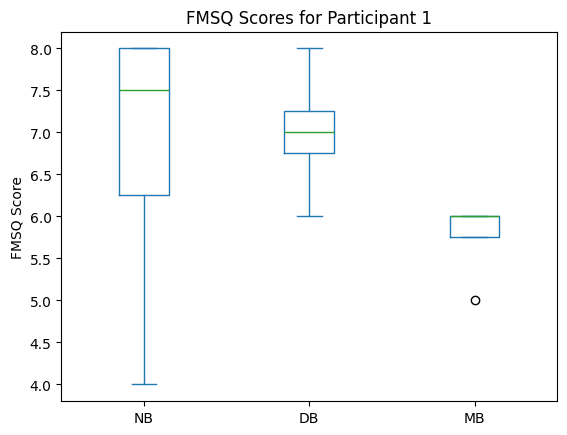

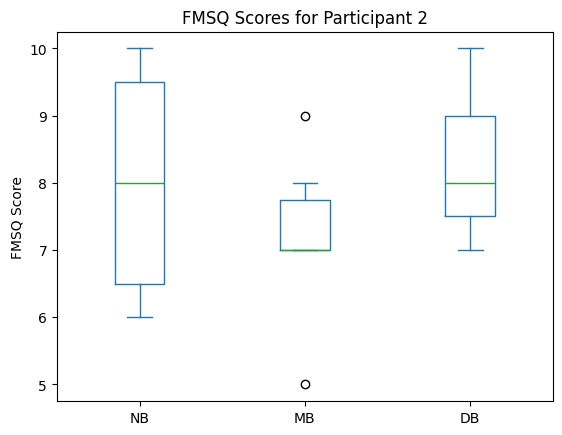

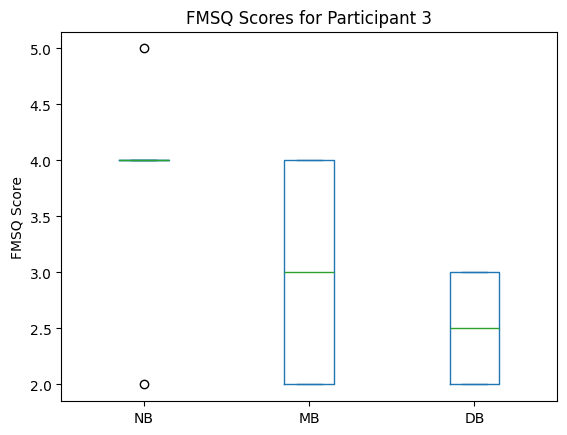

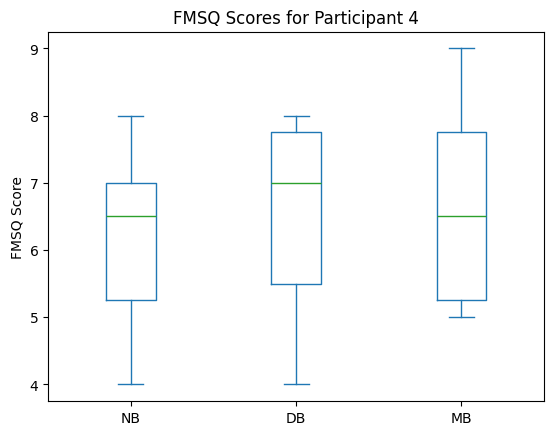

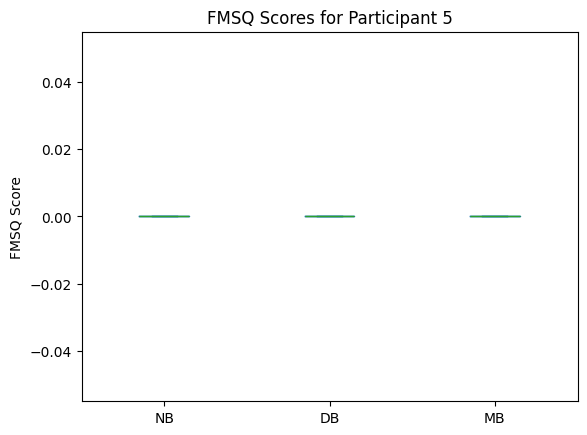

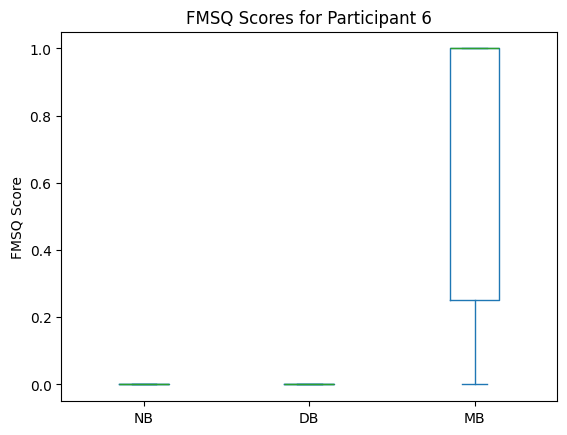

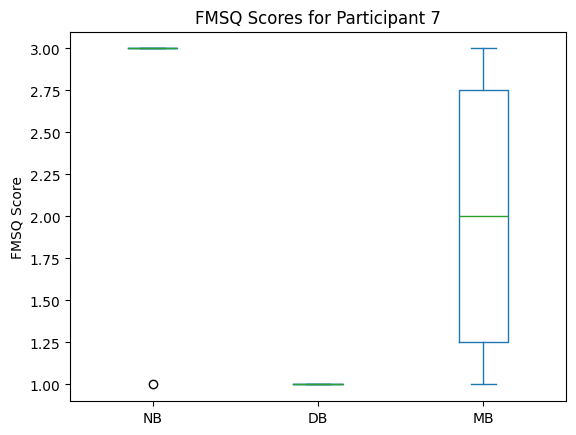

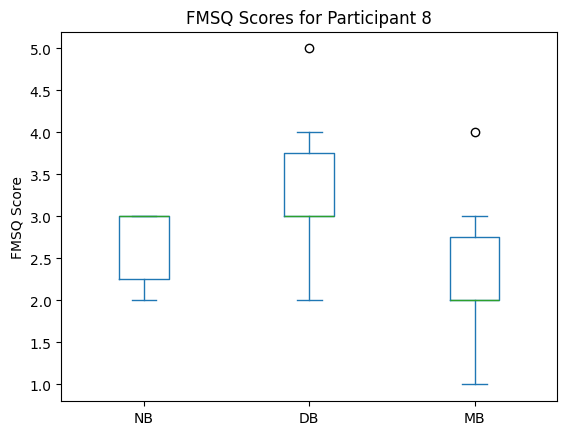

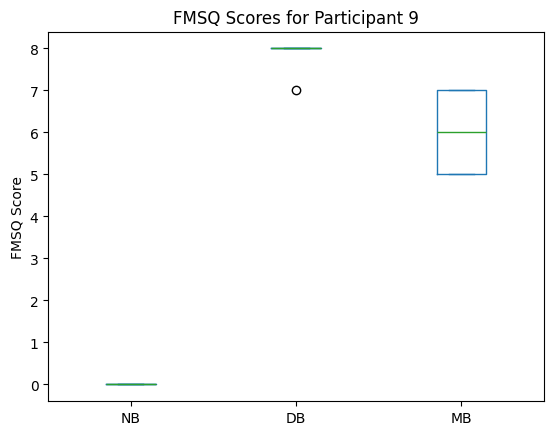

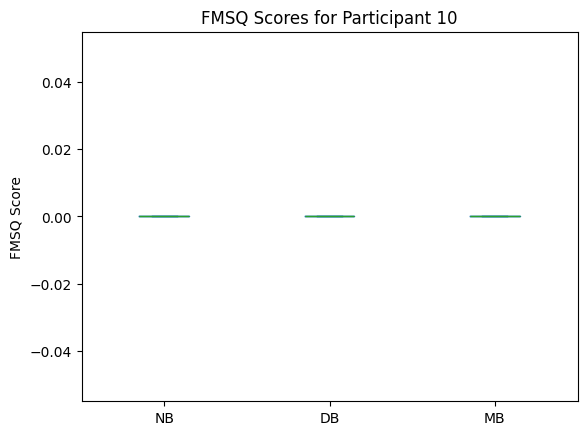

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd

# Loop through users 1 to 10
for i in range(1, 11):
    file_path = f'/content/User{i}_FMS_Data.csv'  # Adjust path if needed
    try:
        df = pd.read_csv(file_path)
        df.plot(kind='box', title=f'FMSQ Scores for Participant {i}')
        plt.ylabel('FMSQ Score')
        plt.show()
    except FileNotFoundError:
        print(f"File for User{i} not found.")


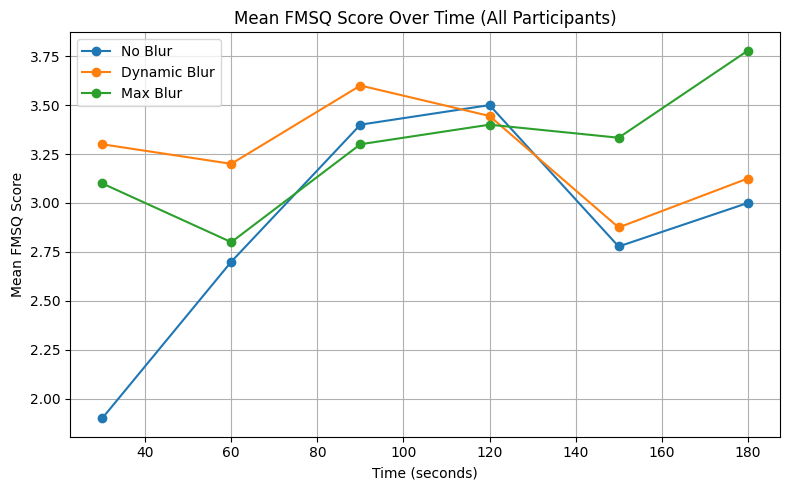

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd

# Initialize list to collect all user data
all_data = []

# Time points
time = [30, 60, 90, 120,150,180]

# Loop over users
for i in range(1, 11):
    file_path = f'/content/User{i}_FMS_Data.csv'
    try:
        df = pd.read_csv(file_path)

        # Add User and Time columns
        df = df[['NB', 'DB', 'MB']].copy()
        df['Time'] = time[:len(df)]  # In case some rows are missing
        df['User'] = f'User{i}'

        all_data.append(df)
    except Exception as e:
        print(f"Skipping User{i}: {e}")

# Combine all user data
combined_df = pd.concat(all_data, ignore_index=True)

# Group by Time and compute mean for each condition
mean_scores = combined_df.groupby('Time')[['NB', 'DB', 'MB']].mean().reset_index()

# Plot
plt.figure(figsize=(8, 5))
plt.plot(mean_scores['Time'], mean_scores['NB'], marker='o', label='No Blur')
plt.plot(mean_scores['Time'], mean_scores['DB'], marker='o', label='Dynamic Blur')
plt.plot(mean_scores['Time'], mean_scores['MB'], marker='o', label='Max Blur')

plt.xlabel('Time (seconds)')
plt.ylabel('Mean FMSQ Score')
plt.title('Mean FMSQ Score Over Time (All Participants)')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


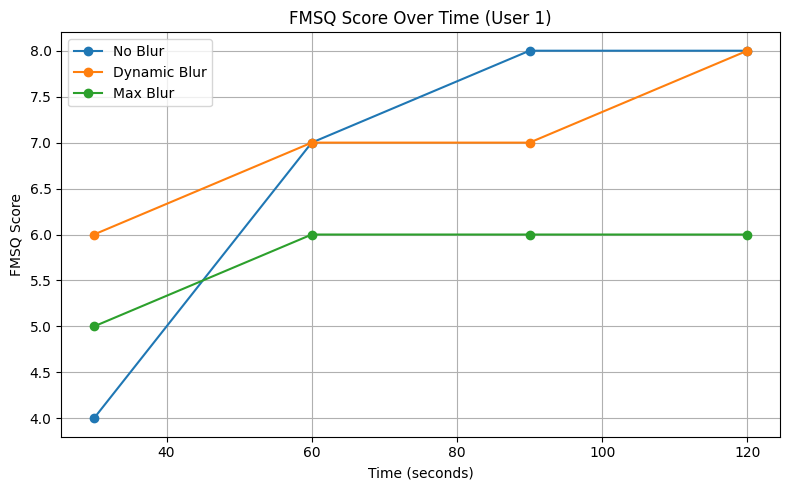

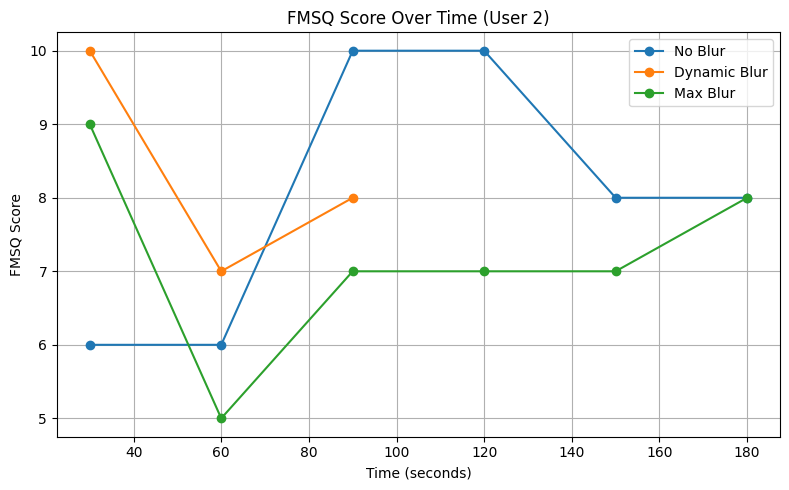

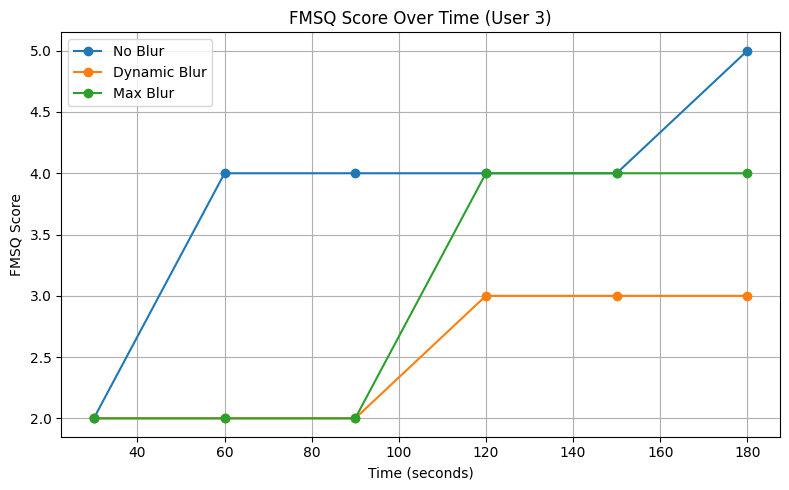

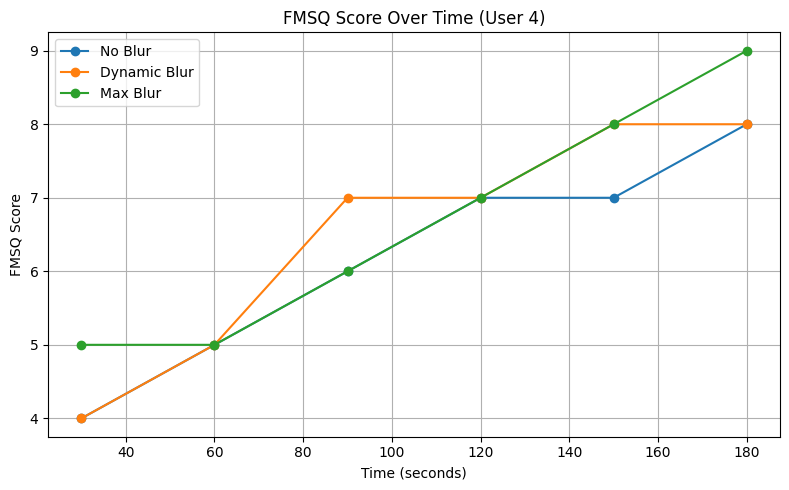

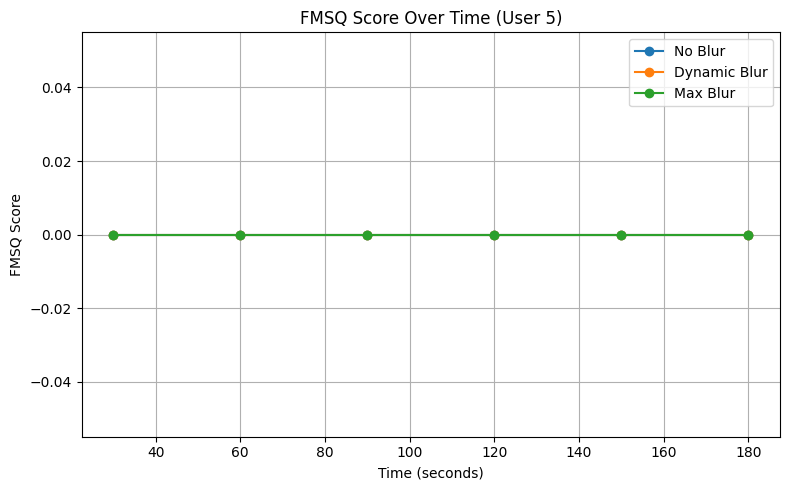

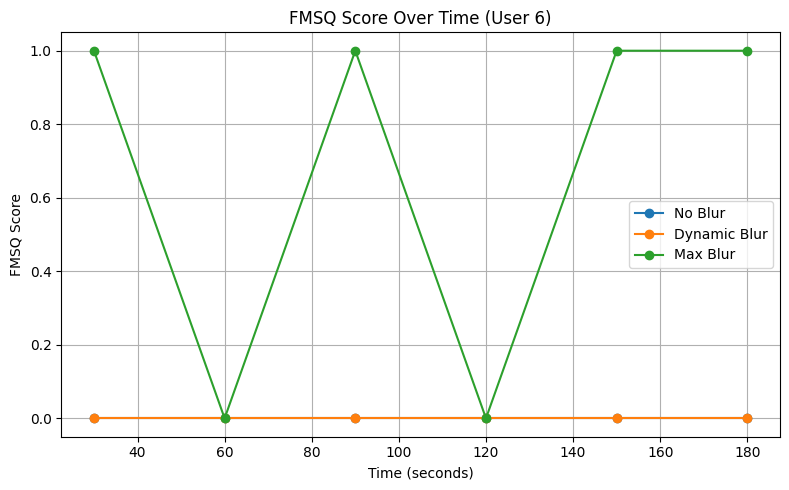

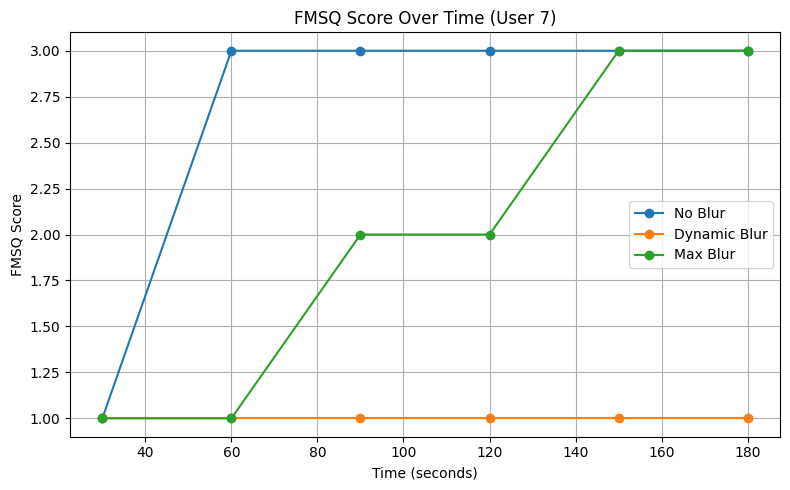

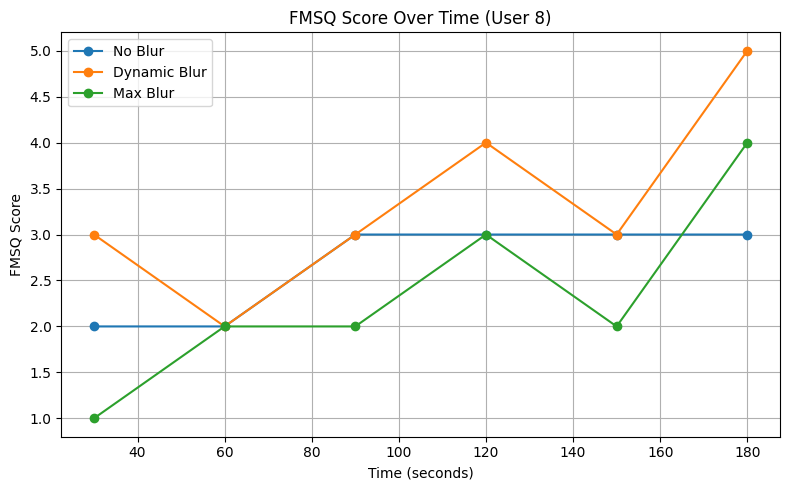

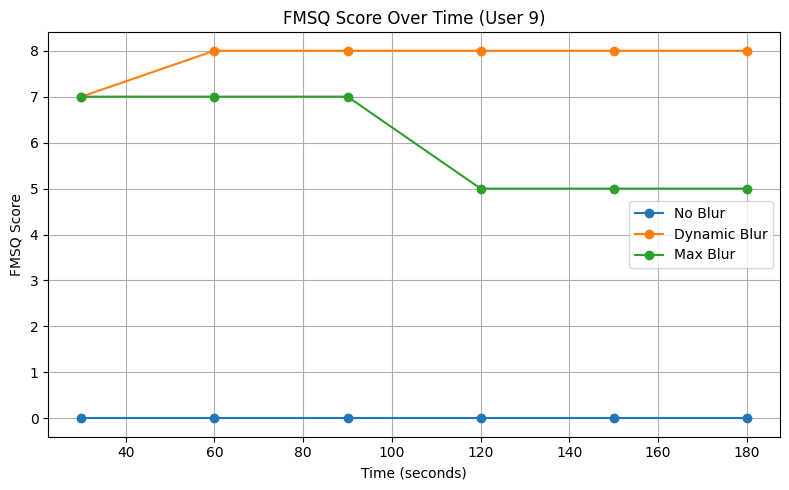

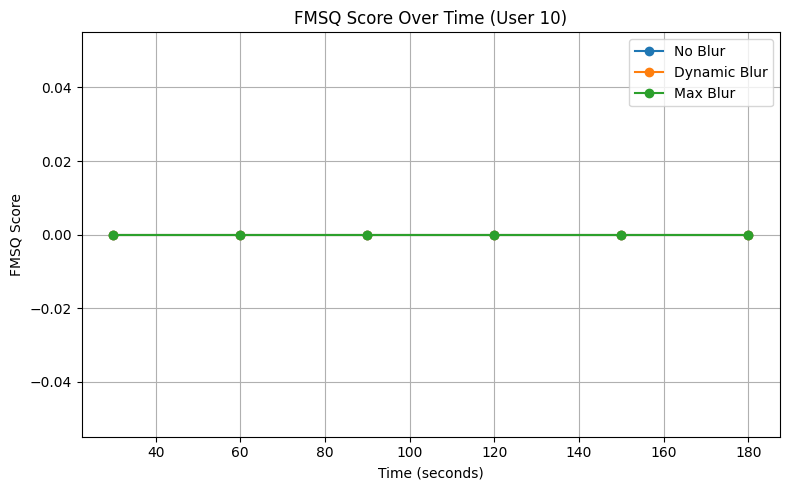

In [ ]:
for i in range(1, 11):
    file_path = f'/content/User{i}_FMS_Data.csv'

    try:
        df = pd.read_csv(file_path)

        # Extract only necessary columns and assign time
        df = df[['NB', 'DB', 'MB']].copy()
        df['Time'] = time[:len(df)]  # Handle missing rows

        # Plot for the user
        plt.figure(figsize=(8, 5))
        plt.plot(df['Time'], df['NB'], marker='o', label='No Blur')
        plt.plot(df['Time'], df['DB'], marker='o', label='Dynamic Blur')
        plt.plot(df['Time'], df['MB'], marker='o', label='Max Blur')

        plt.xlabel('Time (seconds)')
        plt.ylabel('FMSQ Score')
        plt.title(f'FMSQ Score Over Time (User {i})')
        plt.legend()
        plt.grid(True)
        plt.tight_layout()
        plt.show()

    except Exception as e:
        print(f"Skipping User{i}: {e}")

In [ ]:
from scipy.stats import ttest_ind


df = pd.read_csv("User1_Study_FMSQ_Data.csv")


print("T-test between No Blur and Dynamic Blur:", ttest_ind(df['NB_FMSQ'], df['DB_FMSQ']))
print("T-test between No Blur and Max Blur:", ttest_ind(df['NB_FMSQ'], df['MaxBlur_FMSQ']))
print("T-test between Dynamic Blur and Max Blur:", ttest_ind(df['DB_FMSQ'], df['MaxBlur_FMSQ']))

T-test between No Blur and Dynamic Blur: TtestResult(statistic=np.float64(-0.24253562503633297), pvalue=np.float64(0.816443065425582), df=np.float64(6.0))
T-test between No Blur and Max Blur: TtestResult(statistic=np.float64(1.0215078369104984), pvalue=np.float64(0.34642207181242973), df=np.float64(6.0))
T-test between Dynamic Blur and Max Blur: TtestResult(statistic=np.float64(2.6111648393354674), pvalue=np.float64(0.04005780267060112), df=np.float64(6.0))


In [ ]:
df = pd.read_csv("User1_Study_FMSQ_Data.csv")

from scipy.stats import friedmanchisquare

friedmanchisquare(df['NB_FMSQ'], df['DB_FMSQ'], df['MaxBlur_FMSQ'])

FriedmanchisquareResult(statistic=np.float64(4.0), pvalue=np.float64(0.1353352832366127))

analysis of SSQ

In [1]:
import csv


data = [
    (1, "NB", "DB", "MB"),
    (2, "NB", "MB", "DB"),
    (3, "DB", "NB", "MB"),
    (4, "DB", "MB", "NB"),
    (5, "MB", "NB", "DB"),
    (6, "MB", "DB", "NB"),
    (7, "NB", "DB", "MB"),
    (8, "NB", "MB", "DB"),
    (9, "DB", "NB", "MB"),
    (10, "DB", "MB", "NB"),
    (11, "MB", "NB", "DB"),
    (12, "MB", "DB", "NB"),
    (13, "NB", "DB", "MB"),
    (14, "NB", "MB", "DB"),
    (15, "DB", "NB", "MB"),
]

# Write to CSV
with open("session_orders.csv", mode="w", newline="") as file:
    writer = csv.writer(file)
    writer.writerow(["Participant", "Session 1", "Session 2", "Session 3"])
    writer.writerows(data)

print("CSV file 'session_orders.csv' created successfully.")


CSV file 'session_orders.csv' created successfully.


In [ ]:
import pandas as pd
pre_ssq=pd.read_csv('/content/Copy of Pre- Study-SSQ (Responses) - Form Responses 1 (2).csv')
pre_ssq

,Timestamp,Full Name,Date,Session,[General discomfort],[Fatigue],[Headache],[Eye strain],[Difficulty focusing],[Salivation increasing],[Sweating],[Nausea],[Difficulty concentrating],[*Fullness of the Head],[Blurred vision],[Dizziness with eyes open],[Dizziness with eyes closed],[** Vertigo],[*** Stomach awareness],[Burping]
0,4/4/2025 16:45:18,A H M Nazmus Sakib,9/7/1998,1,Slight,Moderate,NaN,Slight,NaN,NaN,NaN,Slight,Slight,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,4/4/2025 17:03:08,A H M Nazmus Sakib,9/7/1998,2,Slight,Slight,NaN,Slight,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,4/4/2025 17:16:36,A H M Nazmus Sakib,9/7/1998,3,Slight,Slight,NaN,Slight,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,4/17/2025 15:20:33,Guohao Yang,5/29/1997,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,4/17/2025 15:38:56,Guohao Yang,5/29/1997,2,Slight,NaN,NaN,NaN,NaN,NaN,Slight,NaN,NaN,NaN,NaN,NaN,NaN,Slight,NaN,NaN
5,4/17/2025 15:53:31,Guohao Yang,5/29/1997,3,Slight,NaN,NaN,NaN,Slight,NaN,Slight,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Slight,NaN
6,4/23/2025 14:03:34,Christina Duthie,12/13/2001,1,NaN,NaN,NaN,Slight,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,4/23/2025 14:22:14,Christina Duthie,12/13/2001,2,NaN,NaN,NaN,Slight,NaN,NaN,NaN,NaN,NaN,Slight,NaN,NaN,NaN,NaN,NaN,NaN
8,4/23/2025 14:35:02,Christina Duthie,12/13/2001,3,NaN,NaN,NaN,Slight,NaN,NaN,NaN,NaN,NaN,Slight,NaN,NaN,NaN,NaN,NaN,NaN
9,4/24/2025 15:22:18,Anshu Tripathi,4/24/2025,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
ssq

,Timestamp,Full Name,Date,General discomfort,Fatigue,Headache,Eye strain,Difficulty focusing,Salivation increasing,Sweating,Nausea,Difficulty concentrating,Fullness of the Head,Blurred vision,Dizziness with eyes open,Dizziness with eyes closed,Vertigo,Stomach awareness,Burping,Condition
0,16/01/2025 17:24:05,Nasim Ahmed,16/01/2025,Slight,NaN,1.0,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,None
1,12/02/2025 15:28:21,Jyotirmay Nag Setu,18/12/1997,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,None
2,12/02/2025 15:53:22,Jyotirmay Nag Setu,18/12/1997,Slight,2.0,1.0,2.0,1.0,2.0,2.0,1.0,1.0,2.0,1.0,1.0,1.0,1.0,1.0,1.0,None
3,12/02/2025 15:55:22,aa,11/11/1111,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,None
4,21/02/2025 10:57:18,Nipa Anjum,25/09/1998,NaN,NaN,NaN,1.0,NaN,1.0,1.0,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,None
5,05/03/2025 14:07:21,Fahmida Yeasmin Sami,05/03/2025,Slight,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,None
6,05/03/2025 15:12:32,Ayantika Rinti Bose,07/06/2000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,None
7,05/03/2025 15:59:55,Md Mamunur Rashid,13/06/1998,Moderate,1.0,1.0,2.0,2.0,1.0,1.0,NaN,1.0,1.0,2.0,1.0,1.0,NaN,1.0,NaN,None
8,06/03/2025 16:08:39,Jordane Tabe Etta,06/03/2025,Slight,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,None
9,06/03/2025 16:49:23,Amie Schneider,06/03/2025,NaN,NaN,1.0,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,None


In [ ]:
import pandas as pd


file_path = "/content/Copy of Pre- Study-SSQ (Responses) - Form Responses 1 (2).csv"
ssq = pd.read_csv(file_path)


ssq.columns = ssq.columns.str.strip().str.replace("*", "", regex=False).str.replace("[", "", regex=False).str.replace("]", "", regex=False).str.strip()


severity_map = {"None": 0, "Slight": 1, "Moderate": 2, "Severe": 3}
symptom_columns = ssq.columns[4:]  # All symptom columns start from the 5th column
ssq[symptom_columns] = ssq[symptom_columns].applymap(severity_map.get)

# Step 3: Define symptoms under each SSQ category
nausea_symptoms = [
    "General discomfort",  "Salivation increasing", "Sweating",
    "Nausea", "Difficulty concentrating",
    "Stomach awareness", "Burping"
]

oculomotor_symptoms = [
    "General discomfort", "Headache", "Eye strain", "Difficulty focusing",
    "Difficulty concentrating", "Blurred vision", "Fatigue"
]

disorientation_symptoms = [
    "Difficulty focusing", "Nausea", "Blurred vision", "Dizziness with eyes open",
    "Dizziness with eyes closed", "Vertigo", "Fullness of the Head"
]

# Step 4: Calculate raw sub-scores
ssq['Nausea_raw'] = ssq[nausea_symptoms].sum(axis=1)
ssq['Oculomotor_raw'] = ssq[oculomotor_symptoms].sum(axis=1)
ssq['Disorientation_raw'] = ssq[disorientation_symptoms].sum(axis=1)

# Step 5: Apply scoring formula
ssq['Nausea'] = ssq['Nausea_raw'] * 9.54
ssq['Oculomotor'] = ssq['Oculomotor_raw'] * 7.58
ssq['Disorientation'] = ssq['Disorientation_raw'] * 13.92
ssq['Total'] = (ssq['Nausea_raw'] + ssq['Oculomotor_raw'] + ssq['Disorientation_raw']) * 3.74

# Step 6: Output results
ssq_scores = ssq[["Full Name", "Session", "Nausea", "Oculomotor", "Disorientation", "Total"]]
print(ssq_scores)



                Full Name  Session Nausea  Oculomotor  Disorientation  Total
0      A H M Nazmus Sakib        1  28.62       37.90           13.92  33.66
1      A H M Nazmus Sakib        2   9.54       22.74            0.00  14.96
2      A H M Nazmus Sakib        3   9.54       22.74            0.00  14.96
3             Guohao Yang        1    0.0        0.00            0.00    0.0
4             Guohao Yang        2  19.08        7.58           13.92  14.96
5             Guohao Yang        3  28.62       15.16           13.92  22.44
6        Christina Duthie        1    0.0        7.58            0.00   3.74
7        Christina Duthie        2    0.0        7.58           13.92   7.48
8        Christina Duthie        3    0.0        7.58           13.92   7.48
9          Anshu Tripathi        1    0.0        0.00            0.00    0.0
10         Anshu Tripathi        2  19.08       22.74           41.76  29.92
11         Anshu Tripathi        3  57.24       53.06           83.52  71.06

/tmp/ipython-input-4-1013341340.py:13: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  ssq[symptom_columns] = ssq[symptom_columns].applymap(severity_map.get)


In [ ]:
ssq_scores["Participant"] = (ssq.groupby("Full Name").ngroup() + 1)
orders = pd.read_csv("session_orders.csv")
# Map session number to condition
def get_condition(row):
    session_value = row["Session"]
    if isinstance(session_value, str):
        session_num = int(session_value.strip()[-1])
    else:
        session_num = int(session_value)
    return orders.loc[orders["Participant"] == row["Participant"], f"Session {session_num}"].values[0]

ssq_scores["Condition"] = ssq_scores.apply(get_condition, axis=1)
ssq_scores.drop(columns=["Full Name"], inplace=True)
ssq_scores.to_csv("pre_ssq.csv", index=False)
ssq_scores


<ipython-input-20-fff78dde1a9c>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  ssq_scores["Participant"] = (ssq.groupby("Full Name").ngroup() + 1)
<ipython-input-20-fff78dde1a9c>:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  ssq_scores["Condition"] = ssq_scores.apply(get_condition, axis=1)
<ipython-input-20-fff78dde1a9c>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user

,Session,Nausea,Oculomotor,Disorientation,Total,Participant,Condition
0,1,28.62,37.90,13.92,33.66,1,NB
1,2,9.54,22.74,0.00,14.96,1,DB
2,3,9.54,22.74,0.00,14.96,1,MB
3,1,0.0,0.00,0.00,0.0,8,NB
4,2,19.08,7.58,13.92,14.96,8,MB
5,3,28.62,15.16,13.92,22.44,8,DB
6,1,0.0,7.58,0.00,3.74,5,MB
7,2,0.0,7.58,13.92,7.48,5,NB
8,3,0.0,7.58,13.92,7.48,5,DB
9,1,0.0,0.00,0.00,0.0,2,NB


In [ ]:
post_ssq=pd.read_csv('/content/Copy of Post- Study-SSQ + IPQ  (Responses) - Form Responses 1 (1).csv')
post_ssq

,Timestamp,Name,Session,"How aware were you of the real world surrounding you while navigating in the virtual world? (i.e. sounds, room temperature, other people, etc.)?",How real did the virtual world seem to you?,"I had a sense of acting in the virtual space, rather than operating something from outside.",How much did your experience in the virtual environment seem consistent with your real-world experience?,How real did the virtual world seem to you?.1,I did not feel present in the virtual space.,I was not aware of my real environment.,...,\nI think that I would like to use this system frequently.,\nI found the system unnecessarily complex.,\nI thought the system was easy to use.,I think that I would need the support of a technical person to be able to use this system.,\nI found the various functions in this system were well integrated.,I thought there was too much inconsistency in this system.,I would imagine that most people would learn to use this system very quickly.,I found the system very cumbersome to use.,I felt very confident using the system.,I needed to learn a lot of things before I could get going with this system.
0,4/4/2025 17:01:16,A H M Nazmus Sakib,1,1,4.0,3,4,4,2,1.0,...,1,4,2,1,4,1,3,5,4,1
1,4/4/2025 17:11:44,A H M Nazmus Sakib,2,1,4.0,3,3,3,3,0.0,...,1,4,3,1,4,1,4,5,4,1
2,4/4/2025 17:23:40,A H M Nazmus Sakib,3,5,4.0,4,3,3,2,0.0,...,1,4,4,1,4,1,4,5,4,1
3,4/17/2025 15:37:12,Guohao Yang,1,1,1.0,5,4,2,3,2.0,...,2,2,3,2,3,1,2,1,2,1
4,4/17/2025 15:48:49,Guohao Yang,2,1,4.0,3,4,2,2,0.0,...,1,3,3,2,2,1,2,1,3,1
5,4/17/2025 16:00:43,Guohao Yang,3,1,4.0,3,3,2,3,0.0,...,2,1,3,1,2,1,2,2,2,1
6,4/23/2025 14:21:00,Christina Duthie,1,2,3.0,5,4,3,4,2.0,...,3,2,5,1,4,1,5,1,5,1
7,4/23/2025 14:33:57,Christina Duthie,2,4,NaN,2,2,2,4,1.0,...,4,2,5,1,5,1,5,1,5,1
8,4/23/2025 14:42:45,Christina Duthie,3,5,1.0,5,0,0,1,6.0,...,1,2,5,1,2,4,5,1,5,1
9,4/24/2025 15:38:18,Anshu Tripathi,1,0,0.0,5,5,5,5,5.0,...,4,2,5,3,5,2,5,4,4,3


In [ ]:
import pandas as pd

# Load the Post SSQ CSV and session order file
post_ssq_path = "/content/Copy of Post- Study-SSQ + IPQ  (Responses) - Form Responses 1 (2).csv"
session_order_path = "/content/session_orders.csv"

post_ssq = pd.read_csv(post_ssq_path)
orders = pd.read_csv(session_order_path)

# Clean column names
post_ssq.columns = post_ssq.columns.str.strip().str.replace("*", "", regex=False).str.replace("[", "", regex=False).str.replace("]", "", regex=False).str.strip()

# Convert symptom labels to numeric values
severity_map = {"None": 0, "Slight": 1, "Moderate": 2, "Severe": 3}
post_ssq.iloc[:, 4:] = post_ssq.iloc[:, 4:].applymap(severity_map.get)

# Add participant ID
post_ssq["Participant"] = post_ssq.groupby("Name").ngroup() + 1

# Map session number to actual condition
def get_condition(row):
    session_val = row["Session"]
    if isinstance(session_val, str):
        session_num = int(session_val.strip()[-1])
    else:
        session_num = int(session_val)
    return orders.loc[orders["Participant"] == row["Participant"], f"Session {session_num}"].values[0]

post_ssq["Condition"] = post_ssq.apply(get_condition, axis=1)

# Define symptom categories
nausea_symptoms = [
    "General discomfort",  "Salivation increasing", "Sweating",
    "Nausea", "Difficulty concentrating",
    "Stomach awareness", "Burping"
]
oculomotor_symptoms = [
    "General discomfort", "Headache", "Eye strain", "Difficulty focusing",
    "Difficulty concentrating", "Blurred vision", "Fatigue"
]
disorientation_symptoms = [
    "Difficulty focusing", "Nausea", "Blurred vision", "Dizziness with eyes open",
    "Dizziness with eyes closed", "Vertigo", "Fullness of the Head"
]
post_ssq_scores = pd.DataFrame()
# Compute SSQ scores
post_ssq_scores["Nausea"] = post_ssq[nausea_symptoms].sum(axis=1) * 9.54
post_ssq_scores["Oculomotor"] = post_ssq[oculomotor_symptoms].sum(axis=1) * 7.58
post_ssq_scores["Disorientation"] = post_ssq[disorientation_symptoms].sum(axis=1) * 13.92
post_ssq_scores["Total"] = (post_ssq[nausea_symptoms + oculomotor_symptoms + disorientation_symptoms].sum(axis=1)) * 3.74

# # Select final output
post_ssq_scores[[ "Participant", "Condition"]] = post_ssq[[ "Participant", "Condition"]]
post_ssq_scores.head()
# post_ssq_scores.to_csv("post_ssq_scores.csv", index=False)


/tmp/ipython-input-18-299935754.py:15: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  post_ssq.iloc[:, 4:] = post_ssq.iloc[:, 4:].applymap(severity_map.get)
/tmp/ipython-input-18-299935754.py:15: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '0     None
1     None
2     None
3     None
4     None
5     None
6     None
7     None
8     None
9     None
10    None
11    None
12    None
13    None
14    None
15    None
16    None
17    None
18    None
19    None
20    None
21    None
22    None
23    None
24    None
25    None
26    None
27    None
28    None
29    None
30    None
31    None
32    None
33    None
34    None
35    None
36    None
37    None
38    None
39    None
40    None
41    None
42    None
43    None
44    None
Name: How real did the virtual world seem to you?, dtype: object' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

IndexError: index 0 is out of bounds for axis 0 with size 0

In [ ]:
 post_ssq_scores

NameError: name 'post_ssq_scores' is not defined

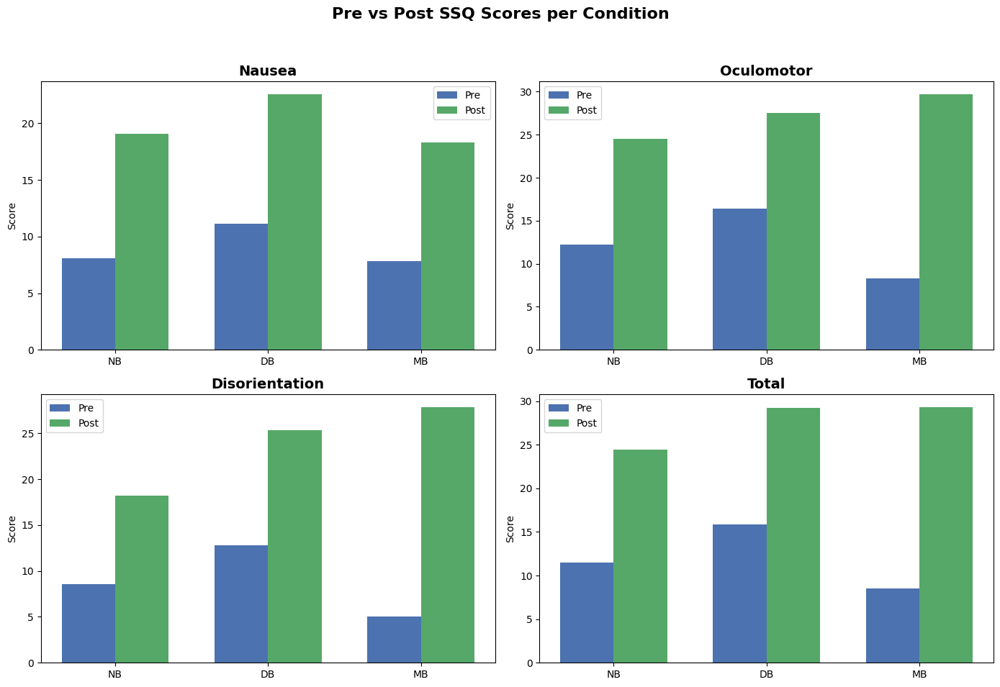

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

# Load data
pre_df = pd.read_csv("pre_ssq.csv")
post_df = pd.read_csv("post_ssq_scores.csv")

# Desired condition order
condition_order = ["NB", "DB", "MB"]

# Group and reorder
pre_grouped = pre_df.groupby("Condition")[["Nausea", "Oculomotor", "Disorientation", "Total"]].mean().loc[condition_order]
post_grouped = post_df.groupby("Condition")[["Nausea", "Oculomotor", "Disorientation", "Total"]].mean().loc[condition_order]

# Plot setup
fig, axs = plt.subplots(2, 2, figsize=(14, 10))
fig.suptitle("Pre vs Post SSQ Scores per Condition", fontsize=16, fontweight='bold')

metrics = ["Nausea", "Oculomotor", "Disorientation", "Total"]
axes = axs.ravel()

x = np.arange(len(condition_order))  # numeric x positions
bar_width = 0.35

# Plot each metric
for i, metric in enumerate(metrics):
    ax = axes[i]
    ax.bar(x - bar_width/2, pre_grouped[metric], width=bar_width, label='Pre', color='#4c72b0')
    ax.bar(x + bar_width/2, post_grouped[metric], width=bar_width, label='Post', color='#55a868')
    ax.set_title(metric, fontsize=14, fontweight='bold')
    ax.set_ylabel("Score")
    ax.set_xticks(x)
    ax.set_xticklabels(condition_order)
    ax.legend()


plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()


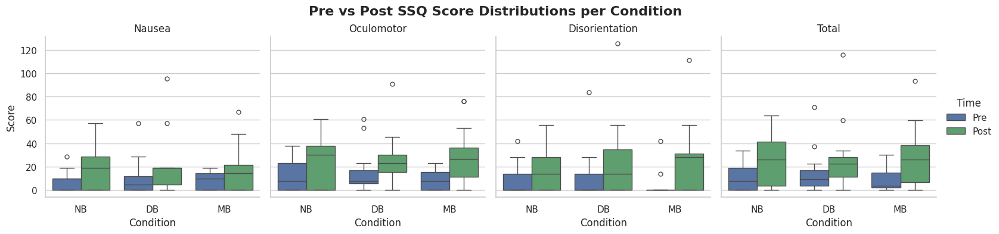

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Load data
pre_df = pd.read_csv("pre_ssq.csv")
post_df = pd.read_csv("post_ssq_scores.csv")

# Label timepoints
pre_df["Time"] = "Pre"
post_df["Time"] = "Post"

# Combine datasets
combined_df = pd.concat([pre_df, post_df], ignore_index=True)

# Melt to long format
melted_df = pd.melt(
    combined_df,
    id_vars=["Condition", "Time"],
    value_vars=["Nausea", "Oculomotor", "Disorientation", "Total"],
    var_name="Metric",
    value_name="Score"
)

# Plotting style
sns.set(style="whitegrid")

# Create boxplots per metric
g = sns.catplot(
    data=melted_df,
    kind="box",
    x="Condition", y="Score",
    hue="Time",
    col="Metric",
    palette=["#4c72b0", "#55a868"],
    height=4, aspect=1
)

g.fig.subplots_adjust(top=0.85)
g.fig.suptitle("Pre vs Post SSQ Score Distributions per Condition", fontsize=16, fontweight='bold')
g.set_titles("{col_name}")
g.set_axis_labels("Condition", "Score")

plt.show()


In [ ]:

merged = pd.merge(pre_df, post_df, on=["Participant", "Condition"], suffixes=("_pre", "_post"))

for metric in ["Nausea", "Oculomotor", "Disorientation", "Total"]:
    merged[f"{metric}_change"] = merged[f"{metric}_post"] - merged[f"{metric}_pre"]
merged

,Session,Nausea_pre,Oculomotor_pre,Disorientation_pre,Total_pre,Participant,Condition,Time_pre,Nausea_post,Oculomotor_post,Disorientation_post,Total_post,Time_post,Nausea_change,Oculomotor_change,Disorientation_change,Total_change
0,1,28.62,37.90,13.92,33.66,1,NB,Pre,57.24,37.90,27.84,48.62,Post,28.62,0.00,13.92,14.96
1,2,9.54,22.74,0.00,14.96,1,DB,Pre,19.08,22.74,13.92,22.44,Post,9.54,0.00,13.92,7.48
2,3,9.54,22.74,0.00,14.96,1,MB,Pre,28.62,30.32,27.84,33.66,Post,19.08,7.58,27.84,18.70
3,1,0.00,0.00,0.00,0.00,3,DB,Pre,38.16,30.32,55.68,44.88,Post,38.16,30.32,55.68,44.88
4,2,19.08,7.58,13.92,14.96,3,NB,Pre,57.24,45.48,55.68,59.84,Post,38.16,37.90,41.76,44.88
5,3,28.62,15.16,13.92,22.44,3,MB,Pre,47.70,53.06,55.68,59.84,Post,19.08,37.90,41.76,37.40
6,1,0.00,7.58,0.00,3.74,2,NB,Pre,0.00,22.74,27.84,18.70,Post,0.00,15.16,27.84,14.96
7,2,0.00,7.58,13.92,7.48,2,MB,Pre,0.00,22.74,41.76,22.44,Post,0.00,15.16,27.84,14.96
8,3,0.00,7.58,13.92,7.48,2,DB,Pre,0.00,7.58,13.92,7.48,Post,0.00,0.00,0.00,0.00


In [ ]:
import scipy.stats as stats

# One-way ANOVA for each metric
for metric in ["Nausea", "Oculomotor", "Disorientation", "Total"]:
    print(f"\nANOVA for {metric} Change:")
    groups = [group[metric + "_change"].values for name, group in merged.groupby("Condition")]
    f_stat, p_val = stats.f_oneway(*groups)
    print(f"F = {f_stat:.4f}, p = {p_val:.4f}")


ANOVA for Nausea Change:
F = 0.2333, p = 0.7988

ANOVA for Oculomotor Change:
F = 0.2708, p = 0.7716

ANOVA for Disorientation Change:
F = 0.1765, p = 0.8424

ANOVA for Total Change:
F = 0.1416, p = 0.8708


In [ ]:
from statsmodels.stats.multicomp import pairwise_tukeyhsd

for metric in ["Nausea", "Oculomotor", "Disorientation", "Total"]:
    print(f"\nPost Hoc Tukey HSD for {metric} Change:")
    tukey = pairwise_tukeyhsd(endog=merged[f"{metric}_change"], groups=merged["Condition"], alpha=0.05)
    print(tukey)



Post Hoc Tukey HSD for Nausea Change:
Multiple Comparison of Means - Tukey HSD, FWER=0.05
group1 group2 meandiff p-adj   lower  upper  reject
---------------------------------------------------
    DB     MB    14.31 0.4061 -25.555 54.175  False
    DB     NB    19.08 0.2588 -20.785 58.945  False
    MB     NB     4.77 0.8766 -35.095 44.635  False
---------------------------------------------------

Post Hoc Tukey HSD for Oculomotor Change:
  Multiple Comparison of Means - Tukey HSD, FWER=0.05  
group1 group2 meandiff p-adj    lower    upper   reject
-------------------------------------------------------
    DB     MB     3.79 0.9857  -93.8379 101.4179  False
    DB     NB    -3.79 0.9857 -101.4179  93.8379  False
    MB     NB    -7.58 0.9447 -105.2079  90.0479  False
-------------------------------------------------------

Post Hoc Tukey HSD for Disorientation Change:
 Multiple Comparison of Means - Tukey HSD, FWER=0.05 
group1 group2 meandiff p-adj   lower    upper  reject
-------

In [ ]:
import statsmodels.formula.api as smf
pre_df["Time"] = "Pre"
post_df["Time"] = "Post"

# Combine pre and post into one long dataframe
combined = pd.concat([pre_df, post_df])
metrics = ["Nausea", "Oculomotor", "Disorientation", "Total"]

for metric in metrics:
    print(f"\nDiD analysis for {metric}:")
    formula = f"{metric} ~ C(Time) * C(Condition)"
    model = smf.ols(formula, data=combined).fit()
    print(model.summary())


DiD analysis for Nausea:
                            OLS Regression Results                            
Dep. Variable:                 Nausea   R-squared:                       0.571
Model:                            OLS   Adj. R-squared:                  0.214
Method:                 Least Squares   F-statistic:                     1.600
Date:                Tue, 22 Apr 2025   Prob (F-statistic):              0.290
Time:                        22:27:02   Log-Likelihood:                -46.526
No. Observations:                  12   AIC:                             105.1
Df Residuals:                       6   BIC:                             108.0
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                                        coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------

/usr/local/lib/python3.11/dist-packages/scipy/stats/_axis_nan_policy.py:418: UserWarning: `kurtosistest` p-value may be inaccurate with fewer than 20 observations; only n=12 observations were given.
  return hypotest_fun_in(*args, **kwds)
/usr/local/lib/python3.11/dist-packages/scipy/stats/_axis_nan_policy.py:418: UserWarning: `kurtosistest` p-value may be inaccurate with fewer than 20 observations; only n=12 observations were given.
  return hypotest_fun_in(*args, **kwds)
/usr/local/lib/python3.11/dist-packages/scipy/stats/_axis_nan_policy.py:418: UserWarning: `kurtosistest` p-value may be inaccurate with fewer than 20 observations; only n=12 observations were given.
  return hypotest_fun_in(*args, **kwds)
/usr/local/lib/python3.11/dist-packages/scipy/stats/_axis_nan_policy.py:418: UserWarning: `kurtosistest` p-value may be inaccurate with fewer than 20 observations; only n=12 observations were given.
  return hypotest_fun_in(*args, **kwds)


Match timestamp and combine all data for 1 participant and see the difference

significance of NB-DB-MB sequence?

avg of each participants ssq

In [23]:
import pandas as pd

# Load the data
file_path = "/content/Copy of Pre- Study-SSQ (Responses) - Form Responses 1 (2).csv"
ssq = pd.read_csv(file_path)

# Clean column names
ssq.columns = ssq.columns.str.strip().str.replace("*", "", regex=False).str.replace("[", "", regex=False).str.replace("]", "", regex=False).str.strip()

# Convert severity strings to numeric
severity_map = {"None": 0, "Slight": 1, "Moderate": 2, "Severe": 3}
symptom_columns = ssq.columns[4:]
ssq[symptom_columns] = ssq[symptom_columns].applymap(severity_map.get)

# Define SSQ symptom categories
nausea_symptoms = [
    "General discomfort", "Salivation increasing", "Sweating",
    "Nausea", "Difficulty concentrating", "Stomach awareness", "Burping"
]
oculomotor_symptoms = [
    "General discomfort", "Headache", "Eye strain", "Difficulty focusing",
    "Difficulty concentrating", "Blurred vision", "Fatigue"
]
disorientation_symptoms = [
    "Difficulty focusing", "Nausea", "Blurred vision", "Dizziness with eyes open",
    "Dizziness with eyes closed", "Vertigo", "Fullness of the Head"
]

# Calculate raw and scaled SSQ scores
ssq['Nausea_raw'] = ssq[nausea_symptoms].sum(axis=1)
ssq['Oculomotor_raw'] = ssq[oculomotor_symptoms].sum(axis=1)
ssq['Disorientation_raw'] = ssq[disorientation_symptoms].sum(axis=1)

ssq['Nausea'] = ssq['Nausea_raw'] * 9.54
ssq['Oculomotor'] = ssq['Oculomotor_raw'] * 7.58
ssq['Disorientation'] = ssq['Disorientation_raw'] * 13.92
ssq['Total'] = (ssq['Nausea_raw'] + ssq['Oculomotor_raw'] + ssq['Disorientation_raw']) * 3.74

# Normalize names to lowercase to ensure case-insensitive grouping
ssq["Normalized Name"] = ssq["Full Name"].str.lower().str.strip()

# Capture the order of first appearance of each normalized name
name_order = ssq.drop_duplicates("Normalized Name")["Normalized Name"].tolist()

# Group by normalized name and average scores
avg_scores = (
    ssq.groupby("Normalized Name", sort=False)[["Nausea", "Oculomotor", "Disorientation", "Total"]]
    .mean()
    .reindex(name_order)
    .reset_index()
)

# Replace names with Part labels in order of appearance
avg_scores["Participant"] = [int(i+1) for i in range(len(avg_scores))]

# Final output table
final_scores = avg_scores[["Participant", "Nausea", "Oculomotor", "Disorientation", "Total"]]

final_scores.to_csv("pre_ssq_scores.csv", index=False)
final_scores


    participant Nausea Oculomotor Disorientation Total
5             1    0.0        0.0            0.0   0.0
6             1    0.0        0.0            0.0   0.0
7             1    0.0        0.0            0.0   0.0
8             1    0.0        0.0            0.0   0.0
9             1    0.0        0.0            0.0   0.0
10            1    0.0        0.0            0.0   0.0
11            1    0.0        0.0            0.0   0.0
12            1    0.0        0.0            0.0   0.0
13            1    0.0        0.0            0.0   0.0
14            1    0.0        0.0            0.0   0.0
15            1    0.0        0.0            0.0   0.0
16            1    0.0        0.0            0.0   0.0
17            1    0.0        0.0            0.0   0.0
18            1    0.0        0.0            0.0   0.0
19            1    0.0        0.0            0.0   0.0
20            1    0.0        0.0            0.0   0.0
21            1    0.0        0.0            0.0   0.0


/tmp/ipython-input-23-316375948.py:26: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  ssq[symptom_columns] = ssq[symptom_columns].applymap(severity_map.get)


In [24]:
name_orderAssq

[None]

In [ ]:
import pandas as pd

# Read the demographic CSV file
# Replace 'demographic.csv' with your actual file name if different
df = pd.read_csv('/content/Copy of Demographic Information (Responses) - Form responses 1.csv')

# Select and rename relevant columns
# Adjust column names below as needed to match your actual CSV headers
result = df[['Age', 'Gender', 'How often do you use VR devices? ']].copy()
result = result.rename(columns={'How often do you use VR devices? ': 'Prev_VR_Experience'})

# Map participant names to numeric IDs
result.insert(0, 'Participant', range(1, len(result) + 1))

result.to_csv('participant_info.csv', index=False)
result


,Participant,Age,Gender,Prev_VR_Experience
0,1,26,Male,Rarely
1,2,28,Male,Never
2,3,23,Female,Rarely
3,4,27,Female,Never
4,5,18,Male,Frequently
5,6,20,Male,Rarely
6,7,18,Male,Never
7,8,24,Male,Rarely
8,9,25,Male,Rarely
9,10,22,Male,Never


In [ ]:
df

,Timestamp,Full Name,Date of Birth,Age,Height,Gender,How often do you use VR devices?,How would you rate your gaming experience?,Occupation,Ethnicity,Do you wear corrective lenses (glasses or contact lenses)?,Do you have any of the following conditions? (Check all that apply):,Are you currently pregnant?,Have you consumed alcohol or drugs in the past 24 hours?
0,04/04/2025 17:40:36,A H M Nazmus Sakib,07/09/1998,26,5'4'',Male,Rarely,3,Student,South Asian,Yes,Motion sickness,No,No
1,17/04/2025 16:15:37,Guohao Yang,29/05/1997,28,185cm,Male,Never,5,Student,Asian,No,NaN,No,No
2,23/04/2025 15:01:38,Christina Duthie,13/12/2001,23,5.2,Female,Rarely,1,Student,Asian,No,NaN,No,No
3,24/04/2025 16:18:55,Anshu Tripathi,11/06/1997,27,5'3,Female,Never,4,Graduate Research Assistant,Asian,Yes,NaN,No,No
4,25/04/2025 13:19:12,Ethan Briggs,19/05/2006,18,"5,8",Male,Frequently,5,Student,Hispanic,Yes,NaN,No,No
5,25/04/2025 13:59:29,ASENCION,06/12/2004,20,5'11,Male,Rarely,5,NaN,mexican,Yes,Frequent headaches or migraines,No,No
6,25/04/2025 15:04:37,Daniel James Morman,25/05/2006,18,"6'5""",Male,Never,3,Cashier,White (European),No,NaN,No,No
7,29/04/2025 16:07:03,Kevin Mathew Maran,17/09/2000,24,"5' 9""",Male,Rarely,4,Graduate Student,Asian,No,NaN,No,No
8,29/04/2025 17:13:23,Vivek Ahir,28/10/1999,25,1.72,Male,Rarely,4,Student,Asian,Yes,Frequent headaches or migraines,No,No
9,30/04/2025 13:45:10,Jaidheer Sirigineedi,21/05/2002,22,184,Male,Never,4,Student,Asian,Yes,NaN,No,No


In [ ]:
df.columns


Index(['Timestamp', 'Full Name', 'Date of Birth', 'Age', 'Height', 'Gender',
       'How often do you use VR devices? ',
       'How would you rate your gaming experience? ', 'Occupation',
       'Ethnicity',
       'Do you wear corrective lenses (glasses or contact lenses)?  ',
       'Do you have any of the following conditions? (Check all that apply):  ',
       'Are you currently pregnant?  ',
       'Have you consumed alcohol or drugs in the past 24 hours?  '],
      dtype='object')

Prep SSQ for study1 and ridwans data

In [32]:
import pandas as pd
pre_ssq=pd.read_csv('/content/Pre- Study-SSQ + IPQ + NASA (Responses) - Form responses 1 (1).csv').iloc[5:]
post_ssq=pd.read_csv('/content/Post- Study-SSQ + IPQ + NASA (Responses) - Form Responses 1 (1).csv').iloc[2:]
pre_ssq.head()
post_ssq.head()

,Timestamp,Name,How mentally demanding was the task?,How physically demanding was the task?,How hurried or rushed was the pace of the task?,How successful were you in accomplishing what\nyou were asked to do?,How hard did you have to work to accomplish\nyour level of performance?,"How insecure, discouraged, irritated, stressed,\nand annoyed were you?","How aware were you of the real world surrounding you while navigating in the virtual world? (i.e. sounds, room temperature, other people, etc.)?",How real did the virtual world seem to you?,...,\nI found the system unnecessarily complex.,\nI thought the system was easy to use.,I think that I would need the support of a technical person to be able to use this system.,\nI found the various functions in this system were well integrated.,I thought there was too much inconsistency in this system.,I would imagine that most people would learn to use this system very quickly.,I found the system very cumbersome to use.,I felt very confident using the system.,I needed to learn a lot of things before I could get going with this system.,Condition
2,3/5/2025 13:55:31,Fahmida,5,8,7,10,9,8,5,0,...,1,4,2,3,2,4,4,5,3,NaN
3,3/5/2025 14:38:35,Ayantika,9,8,5,10,7,4,1,4,...,1,5,4,5,1,5,2,5,2,NaN
4,3/5/2025 15:30:11,Mamun,7,8,7,7,6,6,2,2,...,1,2,4,3,5,2,2,2,2,NaN
5,3/6/2025 15:33:52,Jordane,7,5,0,10,8,0,5,0,...,2,5,1,5,1,1,3,4,5,NaN
6,3/6/2025 16:19:45,Amie Schneider,0,0,0,10,0,0,5,5,...,1,5,2,3,3,5,3,5,2,NaN


In [27]:
import pandas as pd

# Assume pre_ssq is already loaded (your original data)
ssq = pre_ssq.copy()

# Step 1: Clean column names
ssq.columns = (
    ssq.columns
    .str.strip()
    .str.replace("*", "", regex=False)
    .str.replace("[", "", regex=False)
    .str.replace("]", "", regex=False)
    .str.strip()
)

# Step 2: Normalize names and create participant IDs
ssq["Normalized Name"] = ssq["Full Name"].str.lower().str.strip()
name_order = ssq.drop_duplicates("Normalized Name")["Normalized Name"].tolist()
name_to_id = {name: idx + 1 for idx, name in enumerate(name_order)}
ssq["participant"] = ssq["Normalized Name"].map(name_to_id)
ssq.drop(columns="Normalized Name", inplace=True)

# Step 3: Convert severity strings to numbers
severity_map = {"None": 0, "Slight": 1, "Moderate": 2, "Severe": 3}
symptom_columns = ssq.columns.drop(['Full Name', 'participant'], errors='ignore')
ssq[symptom_columns] = ssq[symptom_columns].applymap(severity_map.get)

# Step 4: Define symptom categories
nausea_symptoms = [
    "General discomfort", "Salivation increasing", "Sweating",
    "Nausea", "Difficulty concentrating", "Stomach awareness", "Burping"
]

oculomotor_symptoms = [
    "General discomfort", "Headache", "Eye strain", "Difficulty focusing",
    "Difficulty concentrating", "Blurred vision", "Fatigue"
]

disorientation_symptoms = [
    "Difficulty focusing", "Nausea", "Blurred vision", "Dizziness with eyes open",
    "Dizziness with eyes closed", "Vertigo", "Fullness of the Head"
]

# Step 5: Compute raw sub-scores
ssq['Nausea_raw'] = ssq[nausea_symptoms].sum(axis=1)
ssq['Oculomotor_raw'] = ssq[oculomotor_symptoms].sum(axis=1)
ssq['Disorientation_raw'] = ssq[disorientation_symptoms].sum(axis=1)

# Step 6: Compute final SSQ scores
ssq['Nausea'] = ssq['Nausea_raw'] * 9.54
ssq['Oculomotor'] = ssq['Oculomotor_raw'] * 7.58
ssq['Disorientation'] = ssq['Disorientation_raw'] * 13.92
ssq['Total'] = (ssq['Nausea_raw'] + ssq['Oculomotor_raw'] + ssq['Disorientation_raw']) * 3.74

# Step 7: Select final output
ssq_scores = ssq[["participant", "Nausea", "Oculomotor", "Disorientation", "Total"]]
print(ssq_scores)
ssq_scores.to_csv("pre_ssq_blurcontrol_utsa.csv", index=False)

    participant  Nausea  Oculomotor  Disorientation  Total
5             1    9.54        7.58            0.00   7.48
6             2    0.00        0.00            0.00   0.00
7             3   57.24       83.38           97.44  89.76
8             4   19.08        7.58            0.00  11.22
9             5   19.08        7.58            0.00  11.22
10            6    9.54       15.16            0.00  11.22
11            7   28.62       30.32           55.68  41.14
12            8    0.00        0.00            0.00   0.00
13            9    9.54        7.58            0.00   7.48
14           10    0.00        0.00            0.00   0.00
15           11    0.00       15.16           13.92  11.22
16           12   66.78       68.22           69.60  78.54
17           13    9.54        0.00            0.00   3.74
18           14    0.00        7.58            0.00   3.74
19           15    0.00        0.00            0.00   0.00
20           16    9.54        7.58            0.00   7.

/tmp/ipython-input-27-2555014086.py:26: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  ssq[symptom_columns] = ssq[symptom_columns].applymap(severity_map.get)


In [33]:
import pandas as pd

# Assume pre_ssq is already loaded (your original data)
ssq = post_ssq.copy()

# Step 1: Clean column names
ssq.columns = (
    ssq.columns
    .str.strip()
    .str.replace("*", "", regex=False)
    .str.replace("[", "", regex=False)
    .str.replace("]", "", regex=False)
    .str.strip()
)

# Step 2: Normalize names and create participant IDs
ssq["Normalized Name"] = ssq["Name"].str.lower().str.strip()
name_order = ssq.drop_duplicates("Normalized Name")["Normalized Name"].tolist()
name_to_id = {name: idx + 1 for idx, name in enumerate(name_order)}
ssq["participant"] = ssq["Normalized Name"].map(name_to_id)
ssq.drop(columns="Normalized Name", inplace=True)

# Step 3: Convert severity strings to numbers
severity_map = {"None": 0, "Slight": 1, "Moderate": 2, "Severe": 3}
symptom_columns = ssq.columns.drop(['Full Name', 'participant'], errors='ignore')
ssq[symptom_columns] = ssq[symptom_columns].applymap(severity_map.get)

# Step 4: Define symptom categories
nausea_symptoms = [
    "General discomfort", "Salivation increasing", "Sweating",
    "Nausea", "Difficulty concentrating", "Stomach awareness", "Burping"
]

oculomotor_symptoms = [
    "General discomfort", "Headache", "Eye strain", "Difficulty focusing",
    "Difficulty concentrating", "Blurred vision", "Fatigue"
]

disorientation_symptoms = [
    "Difficulty focusing", "Nausea", "Blurred vision", "Dizziness with eyes open",
    "Dizziness with eyes closed", "Vertigo", "Fullness of the Head"
]

# Step 5: Compute raw sub-scores
ssq['Nausea_raw'] = ssq[nausea_symptoms].sum(axis=1)
ssq['Oculomotor_raw'] = ssq[oculomotor_symptoms].sum(axis=1)
ssq['Disorientation_raw'] = ssq[disorientation_symptoms].sum(axis=1)

# Step 6: Compute final SSQ scores
ssq['Nausea'] = ssq['Nausea_raw'] * 9.54
ssq['Oculomotor'] = ssq['Oculomotor_raw'] * 7.58
ssq['Disorientation'] = ssq['Disorientation_raw'] * 13.92
ssq['Total'] = (ssq['Nausea_raw'] + ssq['Oculomotor_raw'] + ssq['Disorientation_raw']) * 3.74

# Step 7: Select final output
ssq_scores = ssq[["participant", "Nausea", "Oculomotor", "Disorientation", "Total"]]
print(ssq_scores)
ssq_scores.to_csv("post_ssq_blurcontrol_utsa.csv", index=False)

    participant  Nausea  Oculomotor  Disorientation   Total
2             1   57.24       83.38           41.76   74.80
3             2   38.16       22.74           83.52   48.62
4             3  104.94      106.12          153.12  134.64
5             4   57.24       45.48           69.60   63.58
6             5   19.08       22.74            0.00   18.70
7             6   47.70       53.06           69.60   63.58
8             7   47.70       53.06           55.68   59.84
9             8    0.00        0.00            0.00    0.00
10            9    9.54        7.58           27.84   14.96
11           10   19.08       30.32           13.92   26.18
12           11    9.54        7.58            0.00    7.48
13           12    9.54       37.90           69.60   41.14
14           13    9.54        0.00            0.00    3.74
15           14  162.18       75.80          139.20  138.38
16           15    0.00        0.00            0.00    0.00
17           16   66.78       22.74     

/tmp/ipython-input-33-1380974681.py:26: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  ssq[symptom_columns] = ssq[symptom_columns].applymap(severity_map.get)


In [43]:
MB_pre

,Timestamp,Full Name,Date,Session,[General discomfort],[Fatigue],[Headache],[Eye strain],[Difficulty focusing],[Salivation increasing],[Sweating],[Nausea],[Difficulty concentrating],[*Fullness of the Head],[Blurred vision],[Dizziness with eyes open],[Dizziness with eyes closed],[** Vertigo],[*** Stomach awareness],[Burping]
0,5/8/2025 12:19:51,Sharar Naiarin Haque,5/8/2025,2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,5/14/2025 14:05:33,Md Majedul islam,10/13/1995,2,NaN,NaN,Slight,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,5/14/2025 15:34:15,Kazi Fahim Ahmad Nasif,5/14/2025,3,NaN,NaN,Slight,NaN,Slight,NaN,NaN,Slight,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,5/26/2025 14:30:54,Ambar Conde,5/26/2025,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,5/29/2025 12:50:15,Sarala Gunathilaka,5/29/2025,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,5/30/2025 15:43:12,Tharindu Wijayalath,1/19/1996,3,Slight,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Slight,NaN,NaN,NaN,NaN
6,6/3/2025 14:55:22,Laura Carolina Ospino Marquez,6/3/2025,2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,6/11/2025 20:31:04,Zachary Casimyr,6/11/2025,2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,6/16/2025 18:35:00,shameer shaik,9/4/2000,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,6/20/2025 10:31:48,Mbami Luka,2/16/1998,1,NaN,Slight,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


For Ridwans data

In [45]:
NB_pre = pd.read_csv("/content/NB Pre- Study-SSQ(KSU) (Responses) - Form Responses 1.csv")
DB_pre = pd.read_csv("/content/DB Pre- Study-SSQ(KSU) (Responses) - Form Responses 1.csv")
MB_pre = pd.read_csv("/content/MB Pre- Study-SSQ(KSU) (Responses) - Form Responses 1.csv")


In [39]:
NB_post = pd.read_csv("/content/DB Post- Study-SSQ + IPQ(KSU)  (Responses) - Form Responses 1.csv")
DB_post = pd.read_csv("/content/DB Post- Study-SSQ + IPQ(KSU)  (Responses) - Form Responses 1.csv")
MB_post = pd.read_csv("/content/MB Post- Study-SSQ + IPQ(KSU)  (Responses) - Form Responses 1.csv")


In [46]:
import pandas as pd

# Step 1: Build participant ID mapping from all dataframes
def get_participant_mapping(*dfs):
    all_names = pd.concat([df["Full Name"].str.lower().str.strip() for df in dfs]).drop_duplicates()
    name_to_id = {name: idx + 1 for idx, name in enumerate(all_names)}
    return name_to_id

# Step 2: SSQ scoring function using shared ID map
def compute_ssq_scores(df, name_to_id):
    ssq = df.copy()

    # Clean column names
    ssq.columns = (
        ssq.columns
        .str.strip()
        .str.replace("*", "", regex=False)
        .str.replace("[", "", regex=False)
        .str.replace("]", "", regex=False)
        .str.strip()
    )

    # Normalize names and assign participant IDs
    ssq["Normalized Name"] = ssq["Full Name"].str.lower().str.strip()
    ssq["participant"] = ssq["Normalized Name"].map(name_to_id)

    # Convert severity strings to numbers
    severity_map = {"None": 0, "Slight": 1, "Moderate": 2, "Severe": 3}
    symptom_columns = ssq.columns.drop(['Full Name', 'Normalized Name', 'participant'], errors='ignore')
    ssq[symptom_columns] = ssq[symptom_columns].applymap(severity_map.get)

    # Define symptom categories
    nausea_symptoms = [
        "General discomfort", "Salivation increasing", "Sweating",
        "Nausea", "Difficulty concentrating", "Stomach awareness", "Burping"
    ]
    oculomotor_symptoms = [
        "General discomfort", "Headache", "Eye strain", "Difficulty focusing",
        "Difficulty concentrating", "Blurred vision", "Fatigue"
    ]
    disorientation_symptoms = [
        "Difficulty focusing", "Nausea", "Blurred vision", "Dizziness with eyes open",
        "Dizziness with eyes closed", "Vertigo", "Fullness of the Head"
    ]

    # Compute raw and final scores
    ssq['Nausea_raw'] = ssq[nausea_symptoms].sum(axis=1)
    ssq['Oculomotor_raw'] = ssq[oculomotor_symptoms].sum(axis=1)
    ssq['Disorientation_raw'] = ssq[disorientation_symptoms].sum(axis=1)

    ssq['Nausea'] = ssq['Nausea_raw'] * 9.54
    ssq['Oculomotor'] = ssq['Oculomotor_raw'] * 7.58
    ssq['Disorientation'] = ssq['Disorientation_raw'] * 13.92
    ssq['Total'] = (ssq['Nausea_raw'] + ssq['Oculomotor_raw'] + ssq['Disorientation_raw']) * 3.74

    return ssq[["participant", "Normalized Name", "Nausea", "Oculomotor", "Disorientation", "Total"]]

# Step 3: Process all datasets
name_to_id = get_participant_mapping(NB_pre, DB_pre, MB_pre)
ssq_nb = compute_ssq_scores(NB_pre, name_to_id)
ssq_db = compute_ssq_scores(DB_pre, name_to_id)
ssq_mb = compute_ssq_scores(MB_pre, name_to_id)

# Step 4: Combine and average per participant
combined_ssq = pd.concat([ssq_nb, ssq_db, ssq_mb], ignore_index=True)
avg_ssq = combined_ssq.groupby(["participant", "Normalized Name"], as_index=False).mean(numeric_only=True)

# Final result
print(avg_ssq)


    participant                Normalized Name  Oculomotor  Disorientation
0             1               syeda umme salma   30.320000           13.92
1             2           sharar naiarin haque    0.000000            0.00
2             3               md majedul islam    7.580000            0.00
3             4         kazi fahim ahmad nasif   15.160000           18.56
4             5                    ambar conde    5.053333            0.00
5             6             sarala gunathilaka    7.580000            4.64
6             7                       tharindu    2.526667            4.64
7             8  laura carolina ospino marquez    0.000000            0.00
8             9                      sait suer   18.950000           27.84
9            10                zachary casimyr    7.580000            0.00
10           11                  shameer shaik    2.526667            4.64
11           12                     mbami luka    7.580000            0.00
12           13          

/tmp/ipython-input-46-3174066442.py:30: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  ssq[symptom_columns] = ssq[symptom_columns].applymap(severity_map.get)
/tmp/ipython-input-46-3174066442.py:30: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  ssq[symptom_columns] = ssq[symptom_columns].applymap(severity_map.get)
/tmp/ipython-input-46-3174066442.py:30: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  ssq[symptom_columns] = ssq[symptom_columns].applymap(severity_map.get)


In [50]:
pre_ssq_ridwan=combined_ssq.groupby(["participant", "Normalized Name"], as_index=False).mean()
pre_ssq_ridwan.drop(columns="Normalized Name", inplace=True)
print(pre_ssq_ridwan)
pre_ssq_ridwan.to_csv("pre_ssq_ksu.csv", index=False)

    participant Nausea  Oculomotor  Disorientation      Total
0             1  14.31   30.320000           13.92      24.31
1             2    0.0    0.000000            0.00        0.0
2             3    0.0    7.580000            0.00       3.74
3             4   3.18   15.160000           18.56  13.713333
4             5    0.0    5.053333            0.00   2.493333
5             6   6.36    7.580000            4.64       7.48
6             7   3.18    2.526667            4.64       3.74
7             8    0.0    0.000000            0.00        0.0
8             9  38.16   18.950000           27.84      31.79
9            10    0.0    7.580000            0.00       3.74
10           11    0.0    2.526667            4.64   2.493333
11           12    0.0    7.580000            0.00       3.74
12           13    0.0    0.000000            0.00        0.0
13           14    0.0    0.000000            0.00        0.0
14           15   4.77   11.370000           34.80      16.83
15      

In [53]:
import pandas as pd

# Step 1: Build participant ID mapping from all dataframes
def get_participant_mapping(*dfs):
    all_names = pd.concat([df["Name"].str.lower().str.strip() for df in dfs]).drop_duplicates()
    name_to_id = {name: idx + 1 for idx, name in enumerate(all_names)}
    return name_to_id

# Step 2: SSQ scoring function using shared ID map
def compute_ssq_scores(df, name_to_id):
    ssq = df.copy()

    # Clean column names
    ssq.columns = (
        ssq.columns
        .str.strip()
        .str.replace("*", "", regex=False)
        .str.replace("[", "", regex=False)
        .str.replace("]", "", regex=False)
        .str.strip()
    )

    # Normalize names and assign participant IDs
    ssq["Normalized Name"] = ssq["Name"].str.lower().str.strip()
    ssq["participant"] = ssq["Normalized Name"].map(name_to_id)

    # Convert severity strings to numbers
    severity_map = {"None": 0, "Slight": 1, "Moderate": 2, "Severe": 3}
    symptom_columns = ssq.columns.drop(['Full Name', 'Normalized Name', 'participant'], errors='ignore')
    ssq[symptom_columns] = ssq[symptom_columns].applymap(severity_map.get)

    # Define symptom categories
    nausea_symptoms = [
        "General discomfort", "Salivation increasing", "Sweating",
        "Nausea", "Difficulty concentrating", "Stomach awareness", "Burping"
    ]
    oculomotor_symptoms = [
        "General discomfort", "Headache", "Eye strain", "Difficulty focusing",
        "Difficulty concentrating", "Blurred vision", "Fatigue"
    ]
    disorientation_symptoms = [
        "Difficulty focusing", "Nausea", "Blurred vision", "Dizziness with eyes open",
        "Dizziness with eyes closed", "Vertigo", "Fullness of the Head"
    ]

    # Compute raw and final scores
    ssq['Nausea_raw'] = ssq[nausea_symptoms].sum(axis=1)
    ssq['Oculomotor_raw'] = ssq[oculomotor_symptoms].sum(axis=1)
    ssq['Disorientation_raw'] = ssq[disorientation_symptoms].sum(axis=1)

    ssq['Nausea'] = ssq['Nausea_raw'] * 9.54
    ssq['Oculomotor'] = ssq['Oculomotor_raw'] * 7.58
    ssq['Disorientation'] = ssq['Disorientation_raw'] * 13.92
    ssq['Total'] = (ssq['Nausea_raw'] + ssq['Oculomotor_raw'] + ssq['Disorientation_raw']) * 3.74

    return ssq[["participant", "Normalized Name", "Nausea", "Oculomotor", "Disorientation", "Total"]]

# Step 3: Process all datasets
name_to_id = get_participant_mapping(NB_post, DB_post, MB_post)
ssq_nb = compute_ssq_scores(NB_post, name_to_id)
ssq_db = compute_ssq_scores(DB_post, name_to_id)
ssq_mb = compute_ssq_scores(MB_post, name_to_id)

# Step 4: Combine and average per participant
combined_ssq = pd.concat([ssq_nb, ssq_db, ssq_mb], ignore_index=True)
avg_ssq = combined_ssq.groupby(["participant", "Normalized Name"], as_index=False).mean(numeric_only=True)


# Final result
print(avg_ssq)


    participant                Normalized Name  Oculomotor  Disorientation
0             1               syeda umme salma   68.220000           55.68
1             2           sharar naiarin haque   25.266667           88.16
2             3               md majedul islam    7.580000            0.00
3             4         kazi fahim ahmad nasif   17.686667           23.20
4             5                    ambar conde   42.953333           55.68
5             6             sarala gunathilaka   12.633333            4.64
6             7            tharindu wijayalath   27.793333           27.84
7             8  laura carolina ospino marquez   25.266667           41.76
8             9                      sait suer   45.480000           83.52
9            10                zachary casimyr   12.633333            4.64
10           11                  shameer shaik   30.320000           37.12
11           12                     mbami luka    7.580000            0.00
12           13          

/tmp/ipython-input-53-3188881661.py:30: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  ssq[symptom_columns] = ssq[symptom_columns].applymap(severity_map.get)
/tmp/ipython-input-53-3188881661.py:30: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  ssq[symptom_columns] = ssq[symptom_columns].applymap(severity_map.get)
/tmp/ipython-input-53-3188881661.py:30: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  ssq[symptom_columns] = ssq[symptom_columns].applymap(severity_map.get)


In [54]:
post_ssq_ridwan=combined_ssq.groupby(["participant", "Normalized Name"], as_index=False).mean()
post_ssq_ridwan.drop(columns="Normalized Name", inplace=True)
print(post_ssq_ridwan)
post_ssq_ridwan.to_csv("post_ssq_ksu.csv", index=False)

    participant  Nausea  Oculomotor  Disorientation      Total
0             1   19.08   68.220000           55.68       56.1
1             2    79.5   25.266667           88.16      67.32
2             3     0.0    7.580000            0.00       3.74
3             4    3.18   17.686667           23.20  16.206667
4             5    15.9   42.953333           55.68  42.386667
5             6   19.08   12.633333            4.64      14.96
6             7    9.54   27.793333           27.84  24.933333
7             8    15.9   25.266667           41.76      29.92
8             9  114.48   45.480000           83.52      89.76
9            10     0.0   12.633333            4.64       7.48
10           11   19.08   30.320000           37.12  32.413333
11           12     0.0    7.580000            0.00       3.74
12           13     0.0    0.000000            0.00        0.0
13           14     0.0    0.000000            0.00        0.0
14           15   38.16   45.480000           41.76    